# KNN -  K Nearest Neighbors - Classification

## Imports

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
import itertools
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import NullFormatter
import pandas as pd
import numpy as np
import matplotlib.ticker as ticker
from sklearn import preprocessing
%matplotlib inline

## Data

In [7]:


#df1 = pd.read_csv('waterQuality1.csv')
#df.head()
#df1.head()

In [317]:
#df1['ammonia'].fillna(0)

#df1["is_safe"] = df1["is_safe"].astype(int) 
#df1["is_safe"].astype(int)
#df1["is_safe"]
#df1['ammonia'].astype(str).astype(int)
#df1['is_safe'].astype(int)
#df1['ammonia'] = pd.to_numeric(df1['ammonia'])


In [304]:
#df11.to_csv('water1.csv')

In [397]:
#df1.duplicated().sum()
#df1.iloc[7551,[1]] = 0
df1.iloc[7551,:]

Unnamed: 0     7551.000
aluminium         0.030
ammonia           0.000
arsenic           0.080
barium            0.790
cadmium           0.070
chloramine        0.080
chromium          0.050
copper            0.580
flouride          0.340
bacteria          0.000
viruses           0.000
lead              0.183
nitrates          4.370
nitrites          1.430
mercury           0.007
perchlorate       0.620
radium            2.540
selenium          0.070
silver            0.050
uranium           0.050
is_safe           0.000
Name: 7551, dtype: float64

In [398]:
#df1  '#NUM!'

df1.loc[df1['is_safe']=='#NUM!']

,Unnamed: 0,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,...,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium,is_safe


In [6]:

df1 = df1.drop('Unnamed: 0', axis=1)
df2 = df2.drop('Unnamed: 0', axis=1)







In [5]:
import folium
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.feature_selection import RFE
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegressionCV
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.metrics import recall_score, confusion_matrix, roc_auc_score
import pickle


import warnings
warnings.filterwarnings('ignore')

In [14]:

from numpy import loadtxt
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score



In [86]:
(df1['is_safe'] == 1).sum()

912

In [87]:
(df1['is_safe'] == 0).sum()

7087

In [88]:
7087-912

6175

In [15]:

# continuous_distributions = ['aluminium', 'ammonia','arsenic', 'barium', 'cadmium', 'chloramine', 'chromium', 'copper',
#           'flouride', 'bacteria', 'viruses','lead','nitrates','nitrites',
#           'mercury','perchlorate','radium','selenium','silver','uranium']

# plt.figure(figsize=(22, 18))
# for i, dist_col in enumerate(continuous_distributions):

#   # Create subplots
#     plt.subplot(5,5,i+1)
#     plt.subplots_adjust(hspace = 0.4)
#     sns.histplot(df1[dist_col])
#     plt.title(dist_col + " Dist")

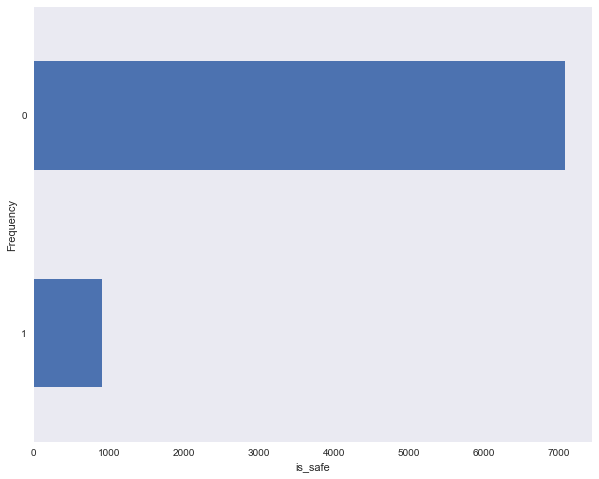

In [89]:
df1['is_safe'].value_counts().sort_values().plot(kind='barh', figsize=(10,8))
plt.xlabel("is_safe")
plt.ylabel("Frequency")
plt.grid()
plt.show()

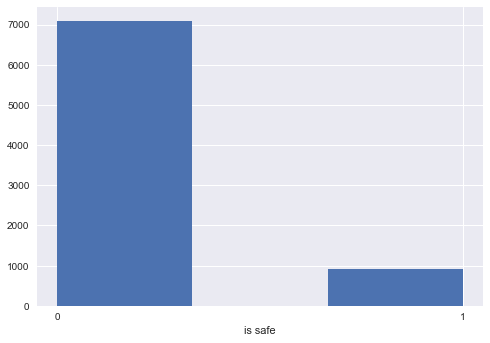

In [75]:
plt.style.use('seaborn')
df1['is_safe'].hist(bins=3)
plt.xlabel("is safe")
plt.xticks(np.arange(0,2))
plt.show()

In [90]:
cor=df1.drop('is_safe',axis=1).corr()
cor

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,viruses,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium
aluminium,1.000000,0.067635,0.225773,0.294145,-0.099911,0.369309,0.353218,0.168612,-0.009784,-0.078238,-0.070863,0.020792,-0.003810,0.237307,-0.003306,0.363069,0.243217,-0.003672,0.334993,0.014711
ammonia,0.067635,1.000000,0.046962,0.070342,-0.006538,0.105187,0.125149,0.016149,-0.027908,0.063800,0.106313,-0.037558,0.006603,-0.063595,0.020300,0.091325,0.050058,0.029804,0.075846,0.014581
arsenic,0.225773,0.046962,1.000000,0.362945,0.334682,0.356559,0.312475,-0.036444,0.003792,0.035688,0.011703,-0.087756,0.027554,0.305005,-0.015404,0.332279,0.218204,-0.007009,0.307837,0.001455
barium,0.294145,0.070342,0.362945,1.000000,-0.037803,0.446928,0.415972,0.065426,-0.018548,0.101259,-0.002276,-0.042888,-0.011331,0.312711,0.005987,0.462234,0.286569,0.035242,0.431606,-0.002440
cadmium,-0.099911,-0.006538,0.334682,-0.037803,1.000000,-0.144370,-0.157766,-0.109024,0.004880,-0.092431,0.021183,-0.034959,0.020194,-0.015682,-0.016174,-0.149344,-0.099259,0.010145,-0.155408,-0.005633
chloramine,0.369309,0.105187,0.356559,0.446928,-0.144370,1.000000,0.555938,0.119059,0.004400,0.154510,0.003687,-0.030479,-0.001551,0.379685,-0.021472,0.588769,0.388806,0.011399,0.522447,-0.007658
chromium,0.353218,0.125149,0.312475,0.415972,-0.157766,0.555938,1.000000,0.113043,-0.002284,0.142041,0.002430,-0.050501,-0.012793,0.335708,-0.022787,0.524532,0.315271,0.030539,0.510768,-0.005526
copper,0.168612,0.016149,-0.036444,0.065426,-0.109024,0.119059,0.113043,1.000000,0.011683,0.149110,0.006292,0.121765,0.002332,0.162093,0.017626,0.104564,0.026215,-0.003267,0.089333,0.006978
flouride,-0.009784,-0.027908,0.003792,-0.018548,0.004880,0.004400,-0.002284,0.011683,1.000000,0.014134,0.018418,0.011905,-0.008140,-0.016669,-0.004400,-0.016191,0.007688,0.022629,0.014554,0.016792
bacteria,-0.078238,0.063800,0.035688,0.101259,-0.092431,0.154510,0.142041,0.149110,0.014134,1.000000,0.618480,-0.027525,-0.033920,0.246252,-0.004471,0.147652,0.099298,-0.006971,0.148225,0.044839


In [91]:
fig = px.imshow(cor,height=800,width=800,color_continuous_scale=colors_blue,template='plotly_white')

fig.update_layout(font_family='monospace',
                title=dict(text='Correlation Heatmap',x=0.5,y=0.93,
                             font=dict(color=colors_dark[2],size=24)),
                coloraxis_colorbar=dict(len=0.85,x=1.1) 
                 )

fig.show()

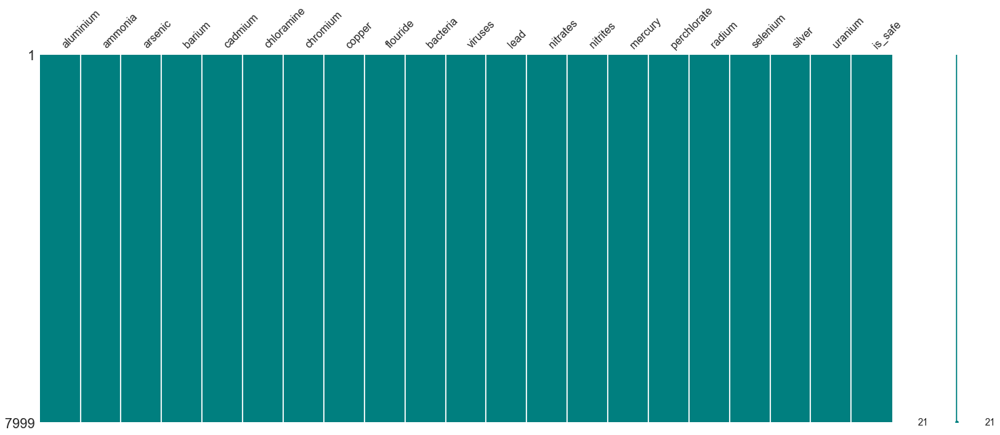

In [92]:
fig = msno.matrix(df1,color=(0,0.5,0.5))

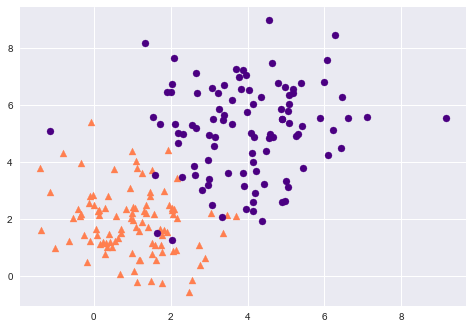

In [94]:
mean_1 = [1, 2]
cov_1 = [[1, 0], [0, 1]]
x_1 = np.random.multivariate_normal(mean_1, cov_1, 100)

mean_2 = [4, 5]
cov_2 = [[2, 0], [0, 2]]
x_2 = np.random.multivariate_normal(mean_2, cov_2, 100)

x = np.concatenate([x_1, x_2])
labels = np.array([0] * 100 + [1] *  100)

plt.scatter(x_1[:, 0], x_1[:, 1], marker = '^', color='coral')
plt.scatter(x_2[:, 0], x_2[:, 1], marker = 'o', color='indigo')
plt.show()

In [9]:
from warnings import filterwarnings
from collections import Counter

# Visualizations Libraries
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.offline as pyo
import plotly.express as px
import plotly.graph_objs as go
pyo.init_notebook_mode()
import plotly.figure_factory as ff
import missingno as msno

# Data Pre-processing Libraries
from sklearn.preprocessing import StandardScaler,MinMaxScaler
from sklearn.model_selection import train_test_split

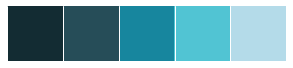

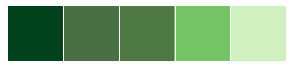

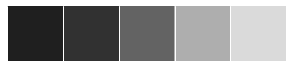

In [63]:
colors_blue = ["#132C33", "#264D58", '#17869E', '#51C4D3', '#B4DBE9']
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
sns.palplot(colors_blue)
sns.palplot(colors_green)
sns.palplot(colors_dark)

In [69]:
fig = px.scatter_matrix(df1,df1.drop('is_safe',axis=1),height=1250,width=1250,template='plotly_white',opacity=0.7,
                        color_discrete_sequence=[colors_blue[3],colors_green[3]],color='is_safe',
                       symbol='is_safe',color_continuous_scale=[colors_green[3],colors_blue[3]])

fig.update_layout(font_family='monospace',font_size=10,
                  coloraxis_showscale=False,
                 legend=dict(x=0.02,y=1.07,bgcolor=colors_dark[4]),
                 title=dict(text='Scatter Plot Matrix',x=0.5,y=0.97,
                   font=dict(color=colors_dark[2],size=24)))
fig.show()

In [9]:
#df1.drop(df1['Unnamed: 0'], inplace= True)

In [10]:
df1.head()

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,...,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium,is_safe
0,1.65,9.08,0.04,2.85,0.007,0.35,0.83,0.17,0.05,0.20,...,0.054,16.08,1.13,0.007,37.75,6.78,0.08,0.34,0.02,1
1,2.32,21.16,0.01,3.31,0.002,5.28,0.68,0.66,0.90,0.65,...,0.100,2.01,1.93,0.003,32.26,3.21,0.08,0.27,0.05,1
2,1.01,14.02,0.04,0.58,0.008,4.24,0.53,0.02,0.99,0.05,...,0.078,14.16,1.11,0.006,50.28,7.07,0.07,0.44,0.01,0
3,1.36,11.33,0.04,2.96,0.001,7.23,0.03,1.66,1.08,0.71,...,0.016,1.41,1.29,0.004,9.12,1.72,0.02,0.45,0.05,1
4,0.92,24.33,0.03,0.20,0.006,2.67,0.69,0.57,0.61,0.13,...,0.117,6.74,1.11,0.003,16.90,2.41,0.02,0.06,0.02,1


In [11]:
#df1.iloc[7890,[1]] = 0  

In [12]:
y = df1['is_safe']
X = df1.drop('is_safe', axis=1)

X.head()

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,viruses,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium
0,1.65,9.08,0.04,2.85,0.007,0.35,0.83,0.17,0.05,0.20,0.000,0.054,16.08,1.13,0.007,37.75,6.78,0.08,0.34,0.02
1,2.32,21.16,0.01,3.31,0.002,5.28,0.68,0.66,0.90,0.65,0.650,0.100,2.01,1.93,0.003,32.26,3.21,0.08,0.27,0.05
2,1.01,14.02,0.04,0.58,0.008,4.24,0.53,0.02,0.99,0.05,0.003,0.078,14.16,1.11,0.006,50.28,7.07,0.07,0.44,0.01
3,1.36,11.33,0.04,2.96,0.001,7.23,0.03,1.66,1.08,0.71,0.710,0.016,1.41,1.29,0.004,9.12,1.72,0.02,0.45,0.05
4,0.92,24.33,0.03,0.20,0.006,2.67,0.69,0.57,0.61,0.13,0.001,0.117,6.74,1.11,0.003,16.90,2.41,0.02,0.06,0.02


In [13]:
X1 = df1.iloc[:,0:-1]
             
X1

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,viruses,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium
0,1.65,9.08,0.04,2.85,0.007,0.35,0.83,0.17,0.05,0.20,0.000,0.054,16.08,1.13,0.007,37.75,6.78,0.08,0.34,0.02
1,2.32,21.16,0.01,3.31,0.002,5.28,0.68,0.66,0.90,0.65,0.650,0.100,2.01,1.93,0.003,32.26,3.21,0.08,0.27,0.05
2,1.01,14.02,0.04,0.58,0.008,4.24,0.53,0.02,0.99,0.05,0.003,0.078,14.16,1.11,0.006,50.28,7.07,0.07,0.44,0.01
3,1.36,11.33,0.04,2.96,0.001,7.23,0.03,1.66,1.08,0.71,0.710,0.016,1.41,1.29,0.004,9.12,1.72,0.02,0.45,0.05
4,0.92,24.33,0.03,0.20,0.006,2.67,0.69,0.57,0.61,0.13,0.001,0.117,6.74,1.11,0.003,16.90,2.41,0.02,0.06,0.02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7994,0.05,7.78,0.00,1.95,0.040,0.10,0.03,0.03,1.37,0.00,0.000,0.197,14.29,1.00,0.005,3.57,2.13,0.09,0.06,0.03
7995,0.05,24.22,0.02,0.59,0.010,0.45,0.02,0.02,1.48,0.00,0.000,0.031,10.27,1.00,0.001,1.48,1.11,0.09,0.10,0.08
7996,0.09,6.85,0.00,0.61,0.030,0.05,0.05,0.02,0.91,0.00,0.000,0.182,15.92,1.00,0.000,1.35,4.84,0.00,0.04,0.05
7997,0.01,10.00,0.01,2.00,0.000,2.00,0.00,0.09,0.00,0.00,0.000,0.000,0.00,0.00,0.000,0.00,0.00,0.00,0.00,0.00


In [14]:
y 

0       1
1       1
2       0
3       1
4       1
       ..
7994    1
7995    1
7996    1
7997    1
7998    1
Name: is_safe, Length: 7999, dtype: int64

In [15]:
df1.value_counts()

aluminium  ammonia  arsenic  barium  cadmium  chloramine  chromium  copper  flouride  bacteria  viruses  lead   nitrates  nitrites  mercury  perchlorate  radium  selenium  silver  uranium  is_safe
0.00       0.03     0.01     1.19    0.006    0.21        0.85      0.58    0.34      0.53      0.530    0.183  4.25      1.21      0.007    25.24        6.53    0.07      0.27    0.05     0          1
0.10       11.80    0.07     0.59    0.030    0.38        0.03      0.05    1.01      0.00      0.000    0.015  9.11      0.74      0.008    0.04         3.21    0.01      0.02    0.00     1          1
           13.62    0.01     0.91    0.020    0.38        0.06      0.97    1.31      0.76      0.760    0.088  9.49      1.10      0.010    8.52         1.04    0.10      0.06    0.06     0          1
           13.49    0.34     1.14    0.100    4.66        0.23      1.69    1.47      0.05      0.008    0.123  6.15      1.20      0.009    40.78        6.13    0.03      0.48    0.05     0       

In [16]:
df1.columns 

Index(['aluminium', 'ammonia', 'arsenic', 'barium', 'cadmium', 'chloramine',
       'chromium', 'copper', 'flouride', 'bacteria', 'viruses', 'lead',
       'nitrates', 'nitrites', 'mercury', 'perchlorate', 'radium', 'selenium',
       'silver', 'uranium', 'is_safe'],
      dtype='object')

In [17]:
X2 = df1[['aluminium', 'ammonia','arsenic', 'barium', 'cadmium', 'chloramine', 'chromium', 'copper',
          'flouride', 'bacteria', 'viruses','lead','nitrates','nitrites',
          'mercury','perchlorate','radium','selenium','silver','uranium']].values  #.astype(float)

y1 = df1['is_safe'].values



In [18]:
#y[0:100]

In [19]:
X22 = preprocessing.StandardScaler().fit(X2).transform(X2)  #normalize 
#X22[0:100] 

In [20]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X22, y1, test_size=0.2, random_state=4)
print ('Train set:', X_train.shape,  y_train.shape)
print ('Test set:', X_test.shape,  y_test.shape)

Train set: (6399, 20) (6399,)
Test set: (1600, 20) (1600,)


In [21]:
from sklearn.neighbors import KNeighborsClassifier

In [22]:
k = 7
#Train Model and Predict  
neigh = KNeighborsClassifier(n_neighbors = k).fit(X_train,y_train)
neigh

KNeighborsClassifier(n_neighbors=7)

In [23]:
yhat = neigh.predict(X_test)
#yhat[0:100]

In [24]:
from sklearn import metrics
print("Train set Accuracy: ", metrics.accuracy_score(y_train, neigh.predict(X_train)))
print("Test set Accuracy: ", metrics.accuracy_score(y_test, yhat))

Train set Accuracy:  0.9335833724019378
Test set Accuracy:  0.91125


In [25]:
#sns.scatterplot(x=yhat,y=X_test,hue='is_safe',data=df1,alpha=0.7)

In [26]:
#sns.scatterplot(x=X22,y=y1,hue='is_safe',data=df1,alpha=0.7)

In [27]:
Ks = 7
mean_acc = np.zeros((Ks-1))
std_acc = np.zeros((Ks-1))
ConfustionMx = [];
for n in range(1,Ks):
    
    #Train Model and Predict  
    neigh = KNeighborsClassifier(n_neighbors = n).fit(X_train,y_train)
    yhat=neigh.predict(X_test)
    mean_acc[n-1] = metrics.accuracy_score(y_test, yhat)

    
    std_acc[n-1]=np.std(yhat==y_test)/np.sqrt(yhat.shape[0])

mean_acc

array([0.84625 , 0.89625 , 0.8975  , 0.905625, 0.901875, 0.90625 ])

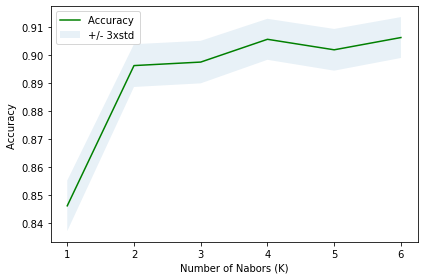

In [28]:
plt.plot(range(1,Ks),mean_acc,'g')
plt.fill_between(range(1,Ks),mean_acc - 1 * std_acc,mean_acc + 1 * std_acc, alpha=0.10)
plt.legend(('Accuracy ', '+/- 3xstd'))
plt.ylabel('Accuracy ')
plt.xlabel('Number of Nabors (K)')
plt.tight_layout()
plt.show()

In [29]:
print( "The best accuracy was with", mean_acc.max(), "with k=", mean_acc.argmax()+1)

The best accuracy was with 0.90625 with k= 6


In [30]:
confusion_matrix(y_test,yhat)

array([[1408,    8],
       [ 142,   42]])

In [8]:
from sklearn.metrics import confusion_matrix

In [10]:
import seaborn as sns
#sns.heatmap(cf_matrix, annot=True)

In [ ]:
sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, 
            fmt='.2%', cmap='Blues')

In [ ]:
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ["{0:0.0f}".format(value) for value in
                cf_matrix.flatten()]
group_percentages = ["{0:.2%}".format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(cf_matrix, annot=labels, fmt='', cmap='Blues')

In [ ]:
from numpy import where
from matplotlib import pyplot
from sklearn.datasets import make_blobs
# generate dataset
#X, y = make_blobs(n_samples=1000, centers=2, n_features=2, random_state=1, cluster_std=3)
# create scatter plot for samples from each class
for class_value in range(2):
	# get row indexes for samples with this class
	row_ix = where(y_test == class_value)
	# create scatter of these samples
	pyplot.scatter(X_test[row_ix,0], X_test[row_ix,1])
# show the plot
pyplot.show()

In [12]:
#df.head()

In [11]:
#sns.scatterplot(x='Gene One',y='Gene Two',hue='Cancer Present',data=df,alpha=0.7)

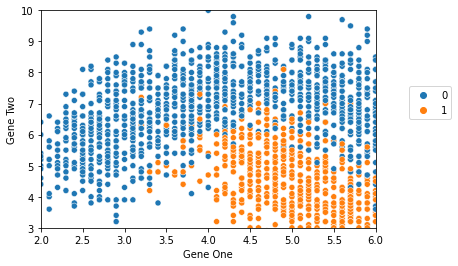

In [6]:
sns.scatterplot(x='Gene One',y='Gene Two',hue='Cancer Present',data=df)
plt.xlim(2,6)
plt.ylim(3,10)
plt.legend(loc=(1.1,0.5))

## Train|Test Split and Scaling Data

In [7]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

In [8]:
X = df.drop('Cancer Present',axis=1)
y = df['Cancer Present']

In [9]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [10]:
scaler = StandardScaler()

In [11]:
scaled_X_train = scaler.fit_transform(X_train)
scaled_X_test = scaler.transform(X_test)

In [12]:
from sklearn.neighbors import KNeighborsClassifier

In [13]:
knn_model = KNeighborsClassifier(n_neighbors=1)

In [14]:
knn_model.fit(scaled_X_train,y_train)

KNeighborsClassifier(n_neighbors=1)

#  KNN and Choosing K Value

In [15]:
full_test = pd.concat([X_test,y_test],axis=1)

In [16]:
len(full_test)

900

<AxesSubplot:xlabel='Gene One', ylabel='Gene Two'>

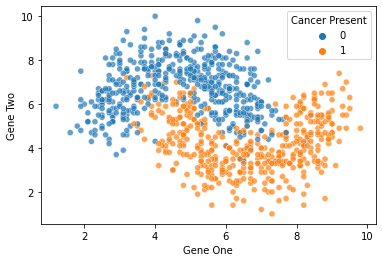

In [17]:
sns.scatterplot(x='Gene One',y='Gene Two',hue='Cancer Present',
                data=full_test,alpha=0.7)

## Model Evaluation

In [18]:
y_pred = knn_model.predict(scaled_X_test)

In [234]:
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score

In [20]:
accuracy_score(y_test,y_pred)

0.8922222222222222

In [21]:
confusion_matrix(y_test,y_pred)

array([[420,  50],
       [ 47, 383]], dtype=int64)

In [22]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.90      0.89      0.90       470
           1       0.88      0.89      0.89       430

    accuracy                           0.89       900
   macro avg       0.89      0.89      0.89       900
weighted avg       0.89      0.89      0.89       900



## Elbow Method for Choosing Reasonable K Values

**NOTE: This uses the test set for the hyperparameter selection of K.**

In [23]:
test_error_rates = []


for k in range(1,30):
    knn_model = KNeighborsClassifier(n_neighbors=k)
    knn_model.fit(scaled_X_train,y_train) 
   
    y_pred_test = knn_model.predict(scaled_X_test)
    
    test_error = 1 - accuracy_score(y_test,y_pred_test)
    test_error_rates.append(test_error)

Text(0.5, 0, 'K Value')

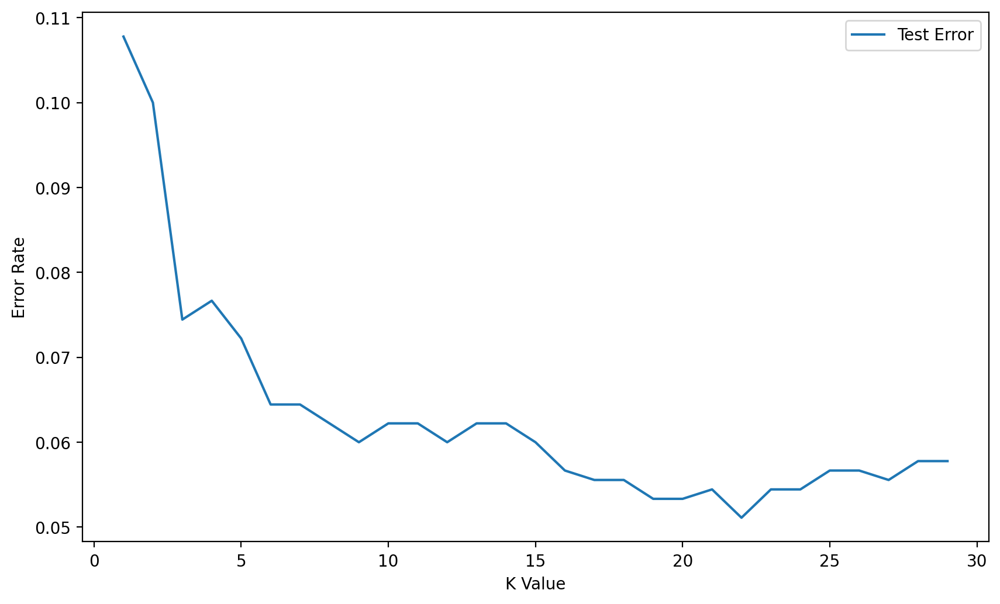

In [24]:
plt.figure(figsize=(10,6),dpi=200)
plt.plot(range(1,30),test_error_rates,label='Test Error')
plt.legend()
plt.ylabel('Error Rate')
plt.xlabel("K Value")

## Full Cross Validation Grid Search for K Value

### Creating a Pipeline to find K value

----

In [24]:
scaler = StandardScaler()

In [25]:
knn = KNeighborsClassifier()

In [26]:
knn.get_params().keys()

dict_keys(['algorithm', 'leaf_size', 'metric', 'metric_params', 'n_jobs', 'n_neighbors', 'p', 'weights'])

In [27]:
# Highly recommend string code matches variable name!
operations = [('scaler',scaler),('knn',knn)]

In [7]:
from sklearn.pipeline import Pipeline

In [29]:
pipe = Pipeline(operations)

In [8]:
from sklearn.model_selection import GridSearchCV

---
*Note: If your parameter grid is going inside a PipeLine, your parameter name needs to be specified in the following manner:**

* chosen_string_name + **two** underscores + parameter key name
* model_name + __ + parameter name
* knn_model + __ + n_neighbors
* knn_model__n_neighbors


In [31]:
k_values = list(range(1,20))

In [32]:
k_values

[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]

In [33]:

param_grid = {'knn__n_neighbors': k_values}

In [34]:
full_cv_classifier = GridSearchCV(pipe,param_grid,cv=5,scoring='accuracy')

In [35]:
# Use full X and y if you DON'T want a hold-out test set
# Use X_train and y_train if you DO want a holdout test set (X_test,y_test)
full_cv_classifier.fit(X_train,y_train)

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('knn', KNeighborsClassifier())]),
             param_grid={'knn__n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11,
                                              12, 13, 14, 15, 16, 17, 18, 19]},
             scoring='accuracy')

In [36]:
full_cv_classifier.best_estimator_.get_params()

{'memory': None,
 'steps': [('scaler', StandardScaler()),
  ('knn', KNeighborsClassifier(n_neighbors=14))],
 'verbose': False,
 'scaler': StandardScaler(),
 'knn': KNeighborsClassifier(n_neighbors=14),
 'scaler__copy': True,
 'scaler__with_mean': True,
 'scaler__with_std': True,
 'knn__algorithm': 'auto',
 'knn__leaf_size': 30,
 'knn__metric': 'minkowski',
 'knn__metric_params': None,
 'knn__n_jobs': None,
 'knn__n_neighbors': 14,
 'knn__p': 2,
 'knn__weights': 'uniform'}

In [37]:
full_cv_classifier.cv_results_.keys()

dict_keys(['mean_fit_time', 'std_fit_time', 'mean_score_time', 'std_score_time', 'param_knn__n_neighbors', 'params', 'split0_test_score', 'split1_test_score', 'split2_test_score', 'split3_test_score', 'split4_test_score', 'mean_test_score', 'std_test_score', 'rank_test_score'])

Let's check our understanding:
**How many total runs did we do?**

In [38]:
len(k_values)

19

In [39]:
full_cv_classifier.cv_results_['mean_test_score']

array([0.90238095, 0.90285714, 0.91857143, 0.91333333, 0.92380952,
       0.92142857, 0.9252381 , 0.9247619 , 0.9252381 , 0.92190476,
       0.9252381 , 0.9247619 , 0.92761905, 0.92904762, 0.92809524,
       0.92809524, 0.92904762, 0.92857143, 0.92761905])

In [40]:
len(full_cv_classifier.cv_results_['mean_test_score'])

19

## Final Model

We just saw that our  GridSearch recommends a K=14 (in line with our alternative Elbow Method). Let's now use the PipeLine again, but this time, no need to do a grid search, instead we will evaluate on our hold-out Test Set.

In [41]:
scaler = StandardScaler()
knn14 = KNeighborsClassifier(n_neighbors=14)
operations = [('scaler',scaler),('knn14',knn14)]

In [42]:
pipe = Pipeline(operations)

In [43]:
pipe.fit(X_train,y_train)

Pipeline(steps=[('scaler', StandardScaler()),
                ('knn14', KNeighborsClassifier(n_neighbors=14))])

In [44]:
pipe_pred = pipe.predict(X_test)

In [45]:
print(classification_report(y_test,pipe_pred))

              precision    recall  f1-score   support

           0       0.93      0.95      0.94       470
           1       0.95      0.92      0.93       430

    accuracy                           0.94       900
   macro avg       0.94      0.94      0.94       900
weighted avg       0.94      0.94      0.94       900



In [46]:
single_sample = X_test.iloc[40]

In [47]:
single_sample

Gene One    3.8
Gene Two    6.3
Name: 194, dtype: float64

In [48]:
pipe.predict(single_sample.values.reshape(1, -1))

array([0], dtype=int64)

In [49]:
pipe.predict_proba(single_sample.values.reshape(1, -1))

array([[0.92857143, 0.07142857]])

In [6]:
from sklearn.tree import DecisionTreeClassifier;

----

In [269]:
drugTree = DecisionTreeClassifier(criterion="entropy", max_depth = 4)
drugTree # it shows the default parameters

DecisionTreeClassifier(criterion='entropy', max_depth=4)

In [270]:
tree = DecisionTreeClassifier(criterion    =  'entropy',
                              max_depth    =  3,
                              random_state =  0 );
tree.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=3, random_state=0)

[Text(167.4, 190.26, '[9.200e-01 2.433e+01 3.000e-02 2.000e-01 6.000e-03 2.670e+00 6.900e-01\n 5.700e-01 6.100e-01 1.300e-01 1.000e-03] <= -0.924\nentropy = 0.511\nsamples = 6399\nvalue = [5671, 728]'),
 Text(83.7, 135.9, '[1.65e+00 9.08e+00 4.00e-02 2.85e+00 7.00e-03 3.50e-01 8.30e-01 1.70e-01\n 5.00e-02 2.00e-01 0.00e+00] <= -0.206\nentropy = 0.894\nsamples = 1798\nvalue = [1239, 559]'),
 Text(41.85, 81.53999999999999, '[1.65e+00 9.08e+00 4.00e-02 2.85e+00 7.00e-03 3.50e-01 8.30e-01 1.70e-01\n 5.00e-02 2.00e-01 0.00e+00] <= -0.404\nentropy = 0.412\nsamples = 1061\nvalue = [973, 88]'),
 Text(20.925, 27.180000000000007, 'entropy = 0.285\nsamples = 865\nvalue = [822, 43]'),
 Text(62.775000000000006, 27.180000000000007, 'entropy = 0.777\nsamples = 196\nvalue = [151, 45]'),
 Text(125.55000000000001, 81.53999999999999, '[2.320e+00 2.116e+01 1.000e-02 3.310e+00 2.000e-03 5.280e+00 6.800e-01\n 6.600e-01 9.000e-01 6.500e-01 6.500e-01] <= 0.13\nentropy = 0.943\nsamples = 737\nvalue = [266, 471

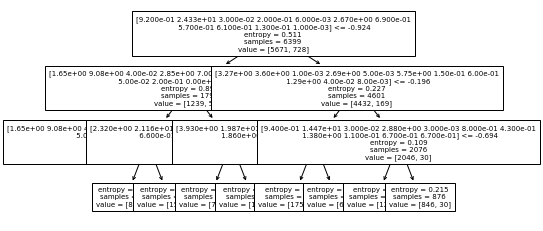

In [277]:
from sklearn.tree import plot_tree;

plot_tree(tree,
          feature_names = X2,
          fontsize      = 7 )

In [278]:
from sklearn.metrics import accuracy_score;
y_pred_train = tree.predict(X_train);
print("Train Set Accuracy : ", accuracy_score(y_train, y_pred_train))
y_pred_test = tree.predict(X_test);
print("Test Set Accuracy  : ", accuracy_score(y_test, y_pred_test))

Train Set Accuracy :  0.9203000468823254
Test Set Accuracy  :  0.919375


In [136]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import accuracy_score, classification_report

from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor




In [137]:
gb = GradientBoostingClassifier()
gb.fit(X_train, y_train)

y_pred_gb = gb.predict(X_test)
#
acc_gb = accuracy_score(y_test, y_pred_gb)
report_gb = classification_report(y_test, y_pred_gb)

print("Accuracy Score of the Gradient Boosting Classifier:", acc_gb)
print("Classification report: \n", report_gb)

Accuracy Score of the Gradient Boosting Classifier: 0.7324516785350966
Classification report: 
               precision    recall  f1-score   support

           0       0.71      0.94      0.81       603
           1       0.82      0.40      0.53       380

    accuracy                           0.73       983
   macro avg       0.76      0.67      0.67       983
weighted avg       0.75      0.73      0.70       983



In [67]:
from Orange.data import Table, Domain
from Orange.classification import SklTreeLearner
from Orange.evaluation import CrossValidation, scoring
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score

# Create the tree
tree = DecisionTreeClassifier(max_depth=6, class_weight='balanced')
tree.fit(X_train,y_train)

#create array of probabilities
#y_test_predict_proba = tree1.predict_proba(X_test)

# calc confusion matrix
y_test_predict = tree.predict(X_test)
print("Confusion Matrix Tree : \n", confusion_matrix(y_test, y_test_predict),"\n")
print("The precision for Tree is ",precision_score(y_test, y_test_predict)) 
print("The recall for Tree is ",recall_score(y_test, y_test_predict),"\n")  

Confusion Matrix Tree : 
 [[365 238]
 [193 187]] 

The precision for Tree is  0.44
The recall for Tree is  0.4921052631578947 



In [308]:
#pip install orange3

In [62]:
import warnings

warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import plotly.express as px
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go

In [365]:
M = df1[df1.is_safe == 0]
B = df1[df1.is_safe == 1]

dff= df1

dff.head()
dff.drop(["Unnamed: 0"], axis = 1)

,aluminium,ammonia,arsenic,barium,cadmium,chloramine,chromium,copper,flouride,bacteria,...,lead,nitrates,nitrites,mercury,perchlorate,radium,selenium,silver,uranium,is_safe
0,1.65,9.08,0.04,2.85,0.007,0.35,0.83,0.17,0.05,0.20,...,0.054,16.08,1.13,0.007,37.75,6.78,0.08,0.34,0.02,1
1,2.32,21.16,0.01,3.31,0.002,5.28,0.68,0.66,0.90,0.65,...,0.100,2.01,1.93,0.003,32.26,3.21,0.08,0.27,0.05,1
2,1.01,14.02,0.04,0.58,0.008,4.24,0.53,0.02,0.99,0.05,...,0.078,14.16,1.11,0.006,50.28,7.07,0.07,0.44,0.01,0
3,1.36,11.33,0.04,2.96,0.001,7.23,0.03,1.66,1.08,0.71,...,0.016,1.41,1.29,0.004,9.12,1.72,0.02,0.45,0.05,1
4,0.92,24.33,0.03,0.20,0.006,2.67,0.69,0.57,0.61,0.13,...,0.117,6.74,1.11,0.003,16.90,2.41,0.02,0.06,0.02,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7994,0.05,7.78,0.00,1.95,0.040,0.10,0.03,0.03,1.37,0.00,...,0.197,14.29,1.00,0.005,3.57,2.13,0.09,0.06,0.03,1
7995,0.05,24.22,0.02,0.59,0.010,0.45,0.02,0.02,1.48,0.00,...,0.031,10.27,1.00,0.001,1.48,1.11,0.09,0.10,0.08,1
7996,0.09,6.85,0.00,0.61,0.030,0.05,0.05,0.02,0.91,0.00,...,0.182,15.92,1.00,0.000,1.35,4.84,0.00,0.04,0.05,1
7997,0.01,10.00,0.01,2.00,0.000,2.00,0.00,0.09,0.00,0.00,...,0.000,0.00,0.00,0.000,0.00,0.00,0.00,0.00,0.00,1


In [366]:
dff.is_safe = [1 if each == 0 else 0 for each in dff.is_safe]
y11 = dff.is_safe.values
x_data = dff.drop(["is_safe"], axis = 1)

In [13]:
# trace1 = go.Scatter3d(
#     x=M.concavity_mean,
#     y=M.area_mean,
#     z=M.texture_mean,
#     mode='markers',
#     name = "malignant",
#     marker=dict(
#         size=M.radius_mean,
#         color='red',                # set color to an array/list of desired values      
#     )
# )

# trace2 = go.Scatter3d(
#     x=B.concavity_mean,
#     y=B.area_mean,
#     z=B.texture_mean,
#     mode='markers',
#     name = "benign", 
#     marker=dict(
#         size=B.radius_mean,
#         color='green',                # set color to an array/list of desired values      
#     )
# )



# data1 = [trace1,trace2]
# layout = go.Layout(
#     scene = dict(
#                     xaxis = dict(
#                         title='Concavity  Mean'),
#                     yaxis = dict(
#                         title='Area Mean'),
#                     zaxis = dict(
#                         title='Texture Mean'),),
#     margin=dict(
#         l=0,
#         r=0,
#         b=0,
#         t=0  
#     )
    
# )
# fig = go.Figure(data=dff, layout=layout)
# iplot(fig, filename='legend-names')

#  Water EDA

<div class="burk">
</div><i class="fa fa-lightbulb-o ">   water PH</i>

In [85]:

df11 = pd.read_csv('water1.csv')
df22 = pd.read_csv('waterNew.csv')




In [92]:
print(df11.info())
print(df22.info())



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3276 entries, 0 to 3275
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ph               3276 non-null   float64
 1   Hardness         3276 non-null   float64
 2   Solids           3276 non-null   float64
 3   Chloramines      3276 non-null   float64
 4   Sulfate          3276 non-null   float64
 5   Conductivity     3276 non-null   float64
 6   Organic_carbon   3276 non-null   float64
 7   Trihalomethanes  3276 non-null   float64
 8   Turbidity        3276 non-null   float64
 9   Potability       3276 non-null   int64  
dtypes: float64(9), int64(1)
memory usage: 256.1 KB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3276 entries, 0 to 3275
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ph               3276 non-null   float64
 1   Hardness         3276 non-null   f

In [89]:
df11.drop(["Unnamed: 0"], axis=1, inplace=True)
df11.head() 

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
0,7.036752,204.890455,20791.318981,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0
1,3.716080,129.422921,18630.057858,6.635246,333.073546,592.885359,15.180013,56.329076,4.500656,0
2,8.099124,224.236259,19909.541732,9.275884,333.073546,418.606213,16.868637,66.420093,3.055934,0
3,8.316766,214.373394,22018.417441,8.059332,356.886136,363.266516,18.436524,100.341674,4.628771,0
4,9.092223,181.101509,17978.986339,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0


In [91]:
print(df11.isna().sum())

df22.drop(["Unnamed: 0"], axis=1, inplace=True)
df11.head()

ph                 0
Hardness           0
Solids             0
Chloramines        0
Sulfate            0
Conductivity       0
Organic_carbon     0
Trihalomethanes    0
Turbidity          0
Potability         0
dtype: int64


,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
0,7.036752,204.890455,20791.318981,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0
1,3.716080,129.422921,18630.057858,6.635246,333.073546,592.885359,15.180013,56.329076,4.500656,0
2,8.099124,224.236259,19909.541732,9.275884,333.073546,418.606213,16.868637,66.420093,3.055934,0
3,8.316766,214.373394,22018.417441,8.059332,356.886136,363.266516,18.436524,100.341674,4.628771,0
4,9.092223,181.101509,17978.986339,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0


<function matplotlib.pyplot.show(close=None, block=None)>

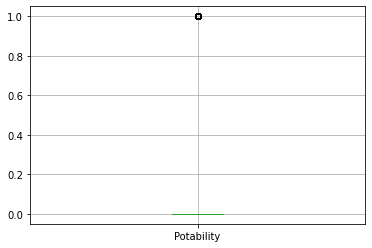

In [21]:
df11.boxplot(column=['Potability'])
plt.show 

In [17]:
#df11[df11['Potability']==0][['ph','Sulfate','Trihalomethanes']].mean()
#df11[df11['Potability']==1][['ph','Sulfate','Trihalomethanes']].mean()
#df11[df11['Potability']==0][['ph','Sulfate','Trihalomethanes']].median()
#df11[df11['Potability']==1][['ph','Sulfate','Trihalomethanes']].median()

ph                   7.085378
Sulfate            334.564290
Trihalomethanes     66.303555
dtype: float64

In [26]:
df11['ph'].fillna(value=df11['ph'].median(),inplace=True)
df11['Sulfate'].fillna(value=df11['Sulfate'].median(),inplace=True)
df11['Trihalomethanes'].fillna(value=df11['Trihalomethanes'].median(),inplace=True)
#df.fillna(dataset.mean(), inplace=True)

In [40]:
df11.isnull().sum()
#df12= df11

ph                 0
Hardness           0
Solids             0
Chloramines        0
Sulfate            0
Conductivity       0
Organic_carbon     0
Trihalomethanes    0
Turbidity          0
Potability         0
dtype: int64

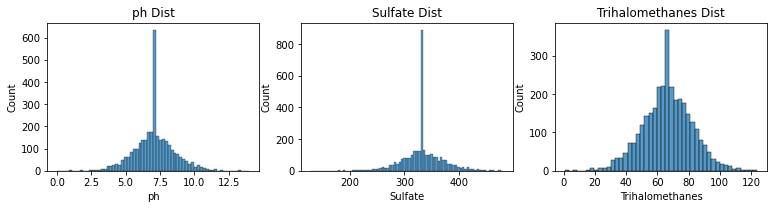

In [31]:
continuous_distributions = ['ph', 'Sulfate','Trihalomethanes']

plt.figure(figsize=(22, 18))
for i, dist_col in enumerate(continuous_distributions):

  # Create subplots
    plt.subplot(5,5,i+1)
    plt.subplots_adjust(hspace = 0.4)
    sns.histplot(df11[dist_col])
    plt.title(dist_col + " Dist")

In [93]:
from sklearn.impute import SimpleImputer
from numpy import nan
from numpy import isnan

#df12= df1[['ph', 'Sulfate','Trihalomethanes']].replace(0, nan)
df11[['ph', 'Sulfate','Trihalomethanes']].values



array([[  7.0367521 , 368.51644135,  86.99097046],
       [  3.71608008, 333.07354575,  56.32907628],
       [  8.09912419, 333.07354575,  66.42009251],
       ...,
       [  9.41951032, 333.07354575,  69.84540029],
       [  5.12676292, 333.07354575,  77.4882131 ],
       [  7.87467136, 333.07354575,  78.69844633]])

In [33]:
df11[['ph', 'Sulfate','Trihalomethanes']].values

imputer = SimpleImputer(missing_values=nan, strategy='median')
transformed_values = imputer.fit_transform(df11[['ph', 'Sulfate','Trihalomethanes']].values)
# count the number of NaN values in each column
print('Missing: %d' % isnan(transformed_values).sum())

Missing: 0


In [34]:
transformed_values

array([[  7.0367521 , 368.51644135,  86.99097046],
       [  3.71608008, 333.07354575,  56.32907628],
       [  8.09912419, 333.07354575,  66.42009251],
       ...,
       [  9.41951032, 333.07354575,  69.84540029],
       [  5.12676292, 333.07354575,  77.4882131 ],
       [  7.87467136, 333.07354575,  78.69844633]])

In [157]:
df12[['ph', 'Sulfate','Trihalomethanes']] = transformed_values 

In [158]:
df12[['ph', 'Sulfate','Trihalomethanes']] 

,ph,Sulfate,Trihalomethanes
0,7.036752,368.516441,86.990970
1,3.716080,333.073546,56.329076
2,8.099124,333.073546,66.420093
3,8.316766,356.886136,100.341674
4,9.092223,310.135738,31.997993
...,...,...,...
3271,4.668102,359.948574,66.687695
3272,7.808856,333.073546,66.622485
3273,9.419510,333.073546,69.845400
3274,5.126763,333.073546,77.488213


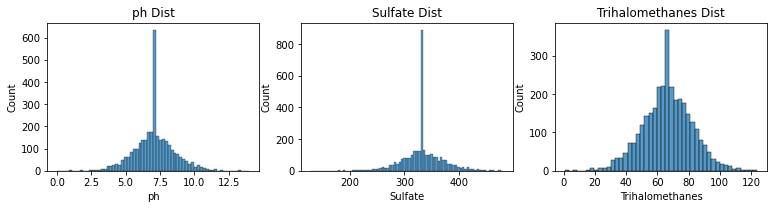

In [35]:
continuous_distributions = ['ph', 'Sulfate','Trihalomethanes']

plt.figure(figsize=(22, 18))
for i, dist_col in enumerate(continuous_distributions):

  # Create subplots
    plt.subplot(5,5,i+1)
    plt.subplots_adjust(hspace = 0.4)
    sns.histplot(df11[dist_col])
    plt.title(dist_col + " Dist")

In [ ]:
#df12

In [319]:
#df11.describe()
#df22

# Statistical analysis¶


In [36]:
df11.describe().T.style.background_gradient(subset=['mean','std','50%','count'], cmap='PuBu') #Feature Solids has the high mean and standard deviation comparted to other feature. so the distribution must be high.

,count,mean,std,min,25%,50%,75%,max
ph,3276.000000,7.074194,1.470040,0.000000,6.277673,7.036752,7.870050,14.000000
Hardness,3276.000000,196.369496,32.879761,47.432000,176.850538,196.967627,216.667456,323.124000
Solids,3276.000000,22014.092526,8768.570828,320.942611,15666.690297,20927.833607,27332.762127,61227.196008
Chloramines,3276.000000,7.122277,1.583085,0.352000,6.127421,7.130299,8.114887,13.127000
Sulfate,3276.000000,333.608364,36.143851,129.000000,317.094638,333.073546,350.385756,481.030642
Conductivity,3276.000000,426.205111,80.824064,181.483754,365.734414,421.884968,481.792304,753.342620
Organic_carbon,3276.000000,14.284970,3.308162,2.200000,12.065801,14.218338,16.557652,28.300000
Trihalomethanes,3276.000000,66.407478,15.769958,0.738000,56.647656,66.622485,76.666609,124.000000
Turbidity,3276.000000,3.966786,0.780382,1.450000,3.439711,3.955028,4.500320,6.739000
Potability,3276.000000,0.390110,0.487849,0.000000,0.000000,0.000000,1.000000,1.000000


In [37]:
df11[df11['Potability']==1].describe().T.style.background_gradient(subset=['mean','std','50%','count'], cmap='PuBu')

,count,mean,std,min,25%,50%,75%,max
ph,1278.000000,7.068655,1.344013,0.227499,6.351824,7.036752,7.780068,13.175402
Hardness,1278.000000,195.800744,35.547041,47.432000,174.330531,196.632907,218.003420,323.124000
Solids,1278.000000,22383.991018,9101.010208,728.750830,15668.985035,21199.386614,27973.236446,56488.672413
Chloramines,1278.000000,7.169338,1.702988,0.352000,6.094134,7.215163,8.199261,13.127000
Sulfate,1278.000000,332.683125,41.865927,129.000000,313.052947,333.073546,354.807924,481.030642
Conductivity,1278.000000,425.383800,82.048446,201.619737,360.939023,420.712729,484.155911,695.369528
Organic_carbon,1278.000000,14.160893,3.263907,2.200000,12.033897,14.162809,16.356245,23.604298
Trihalomethanes,1278.000000,66.543247,15.971950,8.175876,56.911186,66.622485,77.067457,124.000000
Turbidity,1278.000000,3.968328,0.780842,1.492207,3.430909,3.958576,4.509569,6.494249
Potability,1278.000000,1.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [39]:
# Portability is 0 - means not good df.isnull().sum()
df11[df11['Potability']==0].describe().T.style.background_gradient(subset=
                                                                   ['mean','std','50%','count'], cmap='RdBu')
#Mean and std of almost all features are similar for both samples. there are few differnces in Solids feature. Further analysis using hypothetical testing could help us to identify the significance.

,count,mean,std,min,25%,50%,75%,max
ph,1998.000000,7.077736,1.545590,0.000000,6.224046,7.036752,7.940697,14.000000
Hardness,1998.000000,196.733292,31.057540,98.452931,177.823265,197.123423,216.120687,304.235912
Solids,1998.000000,21777.490788,8543.068788,320.942611,15663.057382,20809.618280,27006.249009,61227.196008
Chloramines,1998.000000,7.092175,1.501045,1.683993,6.155640,7.090334,8.066462,12.653362
Sulfate,1998.000000,334.200184,31.948293,203.444521,319.354715,333.073546,348.316746,460.107069
Conductivity,1998.000000,426.730454,80.047317,181.483754,368.498530,422.229331,480.677198,753.342620
Organic_carbon,1998.000000,14.364335,3.334554,4.371899,12.101057,14.293508,16.649485,28.300000
Trihalomethanes,1998.000000,66.320635,15.642787,0.738000,56.441831,66.622485,76.518849,120.030077
Turbidity,1998.000000,3.965800,0.780282,1.450000,3.444062,3.948076,4.496106,6.739000
Potability,1998.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [41]:
df11.isnull().sum()

ph                 0
Hardness           0
Solids             0
Chloramines        0
Sulfate            0
Conductivity       0
Organic_carbon     0
Trihalomethanes    0
Turbidity          0
Potability         0
dtype: int64

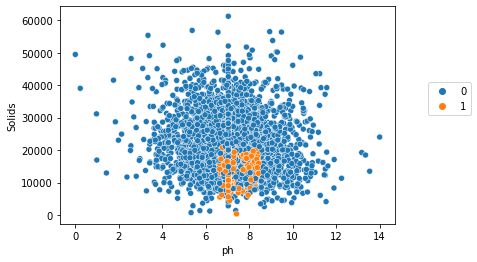

In [189]:
sns.scatterplot(x='ph',y='Solids',hue='Potability',data=df22)

plt.legend(loc=(1.1,0.5))

In [42]:
df11[df11['Sulfate'].isnull()]
df11[df11['ph'].isnull()]
df11[df11['Trihalomethanes'].isnull()]

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability


Text(0.8, 1500, 'Safe for Human consumption')

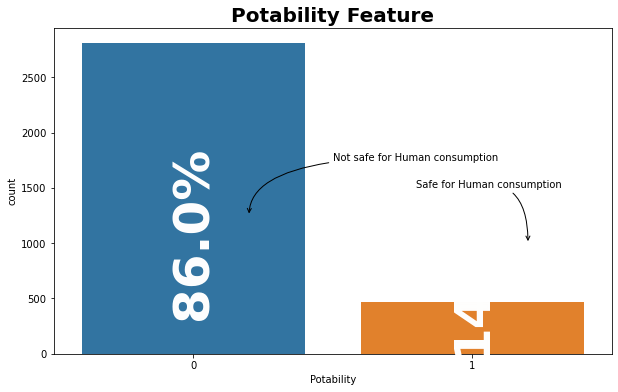

In [235]:
#Lets check the Target features 
fig = plt.figure(figsize=(10,6))
ax=sns.countplot(data=df22, x='Potability')
for i in ax.patches:
    ax.text(x=i.get_x()+i.get_width()/2, y=i.get_height()/7, s=f"{np.round(i.get_height()/len(df22)*100,0)}%", ha='center', size=50, weight='bold', rotation=90, color='white')
plt.title("Potability Feature", size=20, weight='bold')   
plt.annotate(text="Not safe for Human consumption", xytext=(0.5,1750),xy=(0.2,1250), arrowprops =dict(arrowstyle="->", color='black', connectionstyle="angle3,angleA=0,angleB=90"), color='black')
plt.annotate(text="Safe for Human consumption", xytext=(0.8,1500),xy=(1.2,1000), arrowprops =dict(arrowstyle="->", color='black',  connectionstyle="angle3,angleA=0,angleB=90"), color='black')

In [56]:
from sympy import limit

p_value for ph is 0.8630909574232981 we accept the null hypothesis
p_value for Hardness is 0.42854158740864634 we accept the null hypothesis
p_value for Solids is 0.053463638184504905 is less than significant value 0.1, so we have no enough evidance to prove Null Hypothesis. so we reject the Null Hypotesis
p_value for Chloramines is 0.17361022465074671 we accept the null hypothesis
p_value for Sulfate is 0.24132969393720435 we accept the null hypothesis
p_value for Conductivity is 0.6418845485973537 we accept the null hypothesis
p_value for Organic_carbon is 0.08599746163873828 is less than significant value 0.1, so we have no enough evidance to prove Null Hypothesis. so we reject the Null Hypotesis
p_value for Trihalomethanes is 0.6935683946585243 we accept the null hypothesis
p_value for Turbidity is 0.9279391620838058 we accept the null hypothesis
p_value for Potability is 0.0 is less than significant value 0.1, so we have no enough evidance to prove Null Hypothesis. so we reject th

Text(5, 0.12, 'Significance level: 0.1')

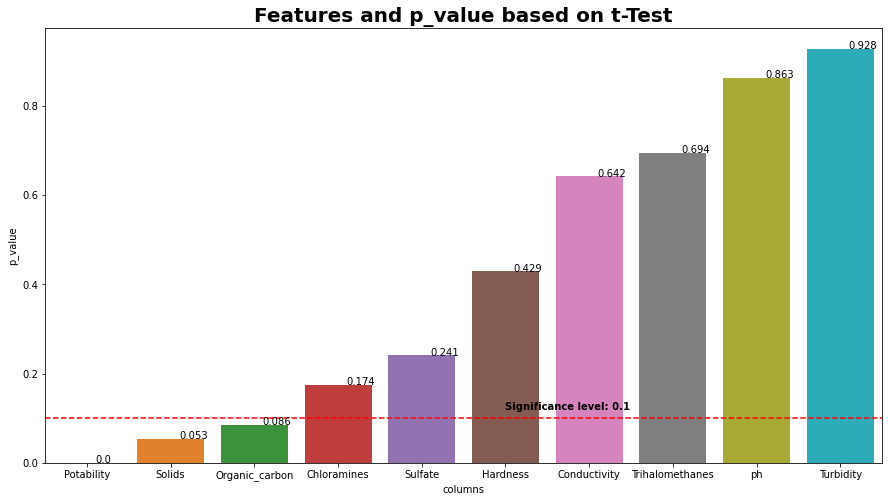

In [78]:
from scipy.stats import ttest_ind
p_val=[]
for i in int_cols:
    pota_1 = df11[df11['Potability']==1][i]
    pota_0 = df11[df11['Potability']==0][i]
    stat, p_value=ttest_ind(pota_1, pota_0)
    p_val.append(np.round(p_value,3))
    if p_value <0.1:
        print(f"p_value for {i} is {p_value} is less than significant value 0.1, so we have no enough evidance to prove Null Hypothesis. so we reject the Null Hypotesis")
    else:
        print(f"p_value for {i} is {p_value} we accept the null hypothesis")

stats_test=pd.DataFrame(columns=['columns','p_value'])
stats_test['columns']=int_cols
stats_test['p_value']=p_val
stats_test.sort_values(by=['p_value'], ascending=True, inplace=True)

fig=plt.figure(figsize=(15,8))
ax=sns.barplot(data=data=stats_test , x='columns',y='p_value')
plt.title("Features and p_value based on t-Test", size=20, weight='bold')
for i in ax.patches:
    ax.text(x=i.get_x()+0.5, y=i.get_height(), s=i.get_height(), rotation=0)
ax.axhline(y=0.1, color='red', ls='--')
ax.text(x=5, y=0.12, s="Significance level: 0.1", weight='bold')

<AxesSubplot:>

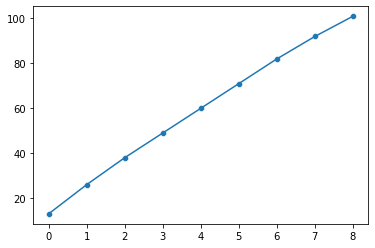

In [97]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
X11 = df11.drop(['Potability'], axis=1)
y11=df11['Potability']

scale = StandardScaler()
X_scaled = scale.fit_transform(X11)
decom = PCA(svd_solver='auto') #let try with auto rather than defining the components
decom.fit(X_scaled)
ex_var=np.cumsum(np.round(decom.explained_variance_ratio_,2))*100
sns.lineplot(y=ex_var, x=np.arange(0,len(ex_var)))
sns.scatterplot(y=ex_var, x=np.arange(0,len(ex_var)))

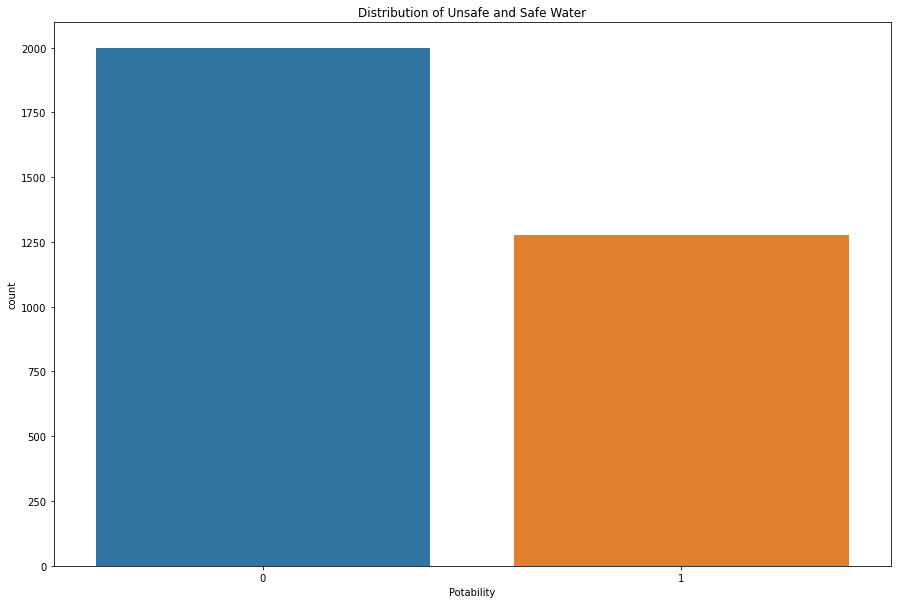

In [35]:
plt.figure(figsize=(15, 10))
sns.countplot(df11.Potability)
plt.title("Distribution of Unsafe and Safe Water")
plt.show()

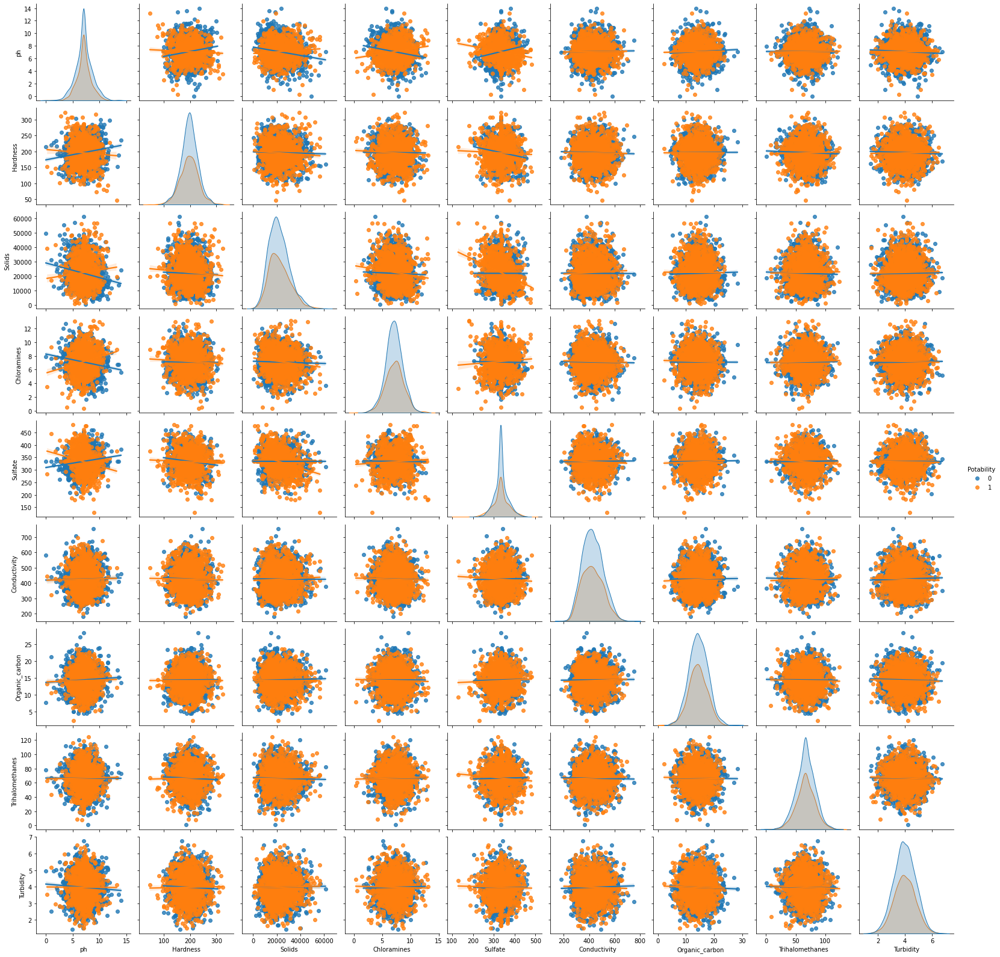

In [98]:
sns.pairplot(df11, hue='Potability', kind='reg')

In [45]:
import plotly.express as px

figure = px.histogram(df11, x = "ph", 
                      color = "Potability", 
                      title= "Factors Affecting Water Quality: PH")
figure.show()

In [46]:
figure = px.histogram(df11, x = "Solids", 
                      color = "Potability", 
                      title= "Factors Affecting Water Quality: Solids")
figure.show()

In [186]:


continuous_distributions = ['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 'Conductivity',
       'Organic_carbon', 'Trihalomethanes', 'Turbidity', 'Potability']





plt.figure(figsize=(22, 18))
for i, dist_col in enumerate(continuous_distributions):
    figure = px.histogram(df11, x = df11[dist_col], 
                      color = "Potability", 
                      title= "Factors Affecting Water Quality: Solids")
    figure.show()


  

<Figure size 1584x1296 with 0 Axes>

In [184]:
df11.columns

Index(['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 'Conductivity',
       'Organic_carbon', 'Trihalomethanes', 'Turbidity', 'Potability'],
      dtype='object')

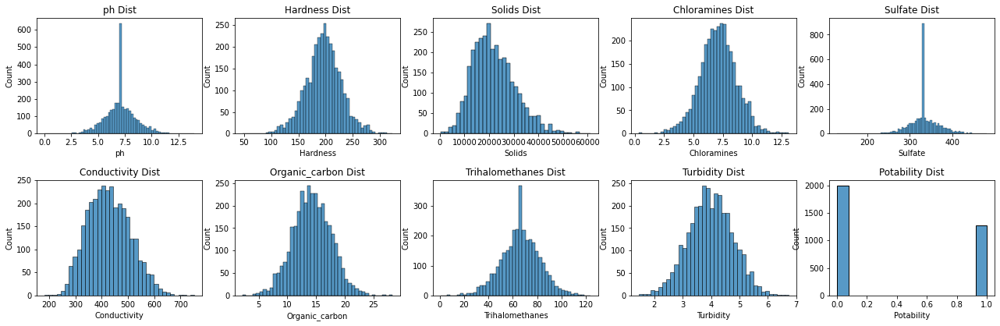

In [38]:
continuous_distributions = ['ph', 'Hardness', 'Solids', 'Chloramines', 'Sulfate', 'Conductivity',
       'Organic_carbon', 'Trihalomethanes', 'Turbidity', 'Potability']





plt.figure(figsize=(22, 18))
for i, dist_col in enumerate(continuous_distributions):

  # Create subplots
    plt.subplot(5,5,i+1)
    plt.subplots_adjust(hspace = 0.4)
    sns.histplot(df11[dist_col])
    plt.title(dist_col + " Dist")

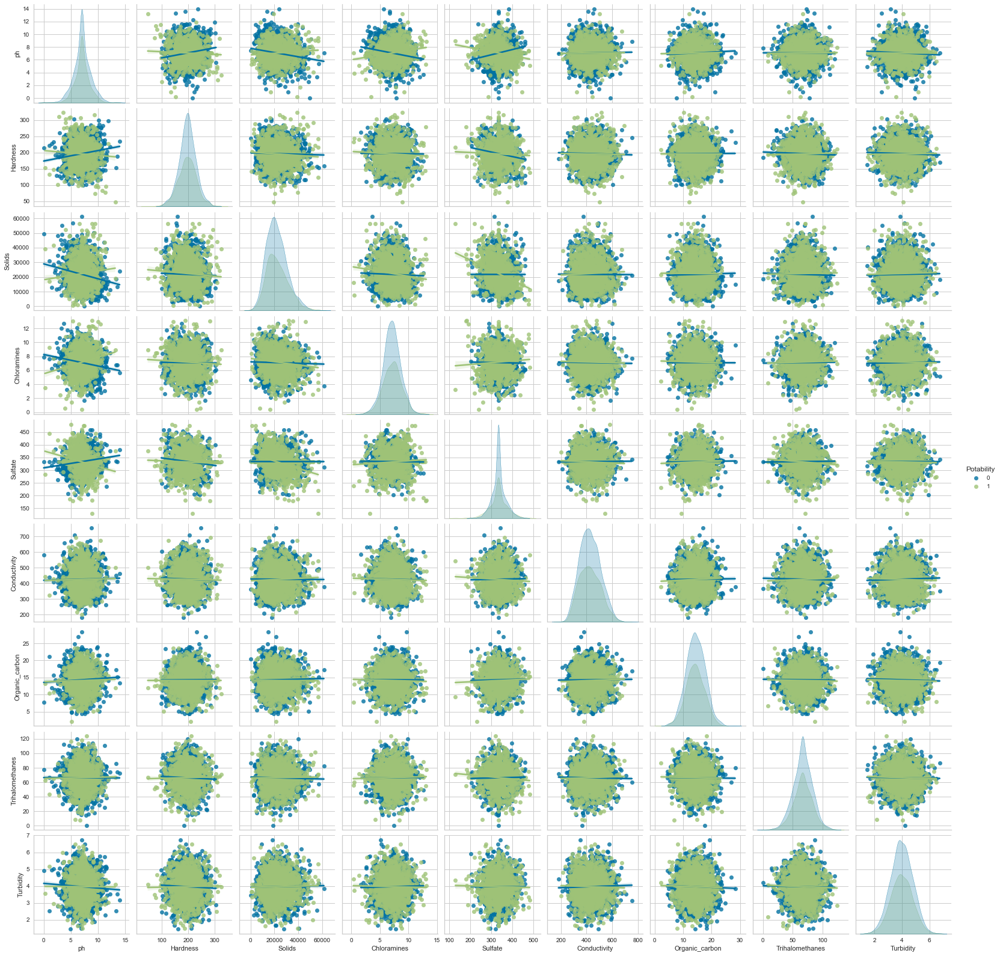

In [69]:
sns.pairplot(df11, hue='Potability', kind='reg')

In [128]:
df11.shape

(3276, 10)

In [79]:
X = df11.drop('Potability',axis=1).values
y = df11['Potability'].values

In [109]:
df11['Potability'].value_counts()

0    1998
1    1278
Name: Potability, dtype: int64

In [123]:
from collections import Counter
from imblearn.under_sampling import RandomUnderSampler

In [124]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=.15, random_state=3)

In [125]:
scaler = StandardScaler()
scaler.fit(X_train)
X_train = scaler.transform(X_train)
X_test = scaler.transform(X_test)

In [126]:
print("Before undersampling: ", Counter(y_train)) 

Before undersampling:  Counter({0: 1704, 1: 1080})


In [129]:
undersample = RandomUnderSampler(sampling_strategy='majority')

In [140]:
X_train_under, y_train_under = undersample.fit_resample(X_train, y_train)

# summarize class distribution
print("After undersampling: ", Counter(y_train_under))

After undersampling:  Counter({0: 1080, 1: 1080})


In [141]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_under = model.fit(X_train_under, y_train_under)
pred_under = clf_under.predict(X_test)

print("ROC AUC score for undersampled data: ", roc_auc_score(y_test, pred_under))

ROC AUC score for undersampled data:  0.7154927118792004


In [142]:
gb = GradientBoostingClassifier()
gb.fit(X_train, y_train)

y_pred_gb = gb.predict(X_test)
#
acc_gb = accuracy_score(y_test, y_pred_gb)
report_gb = classification_report(y_test, y_pred_gb)

print("Accuracy Score of the Gradient Boosting Classifier:", acc_gb)
print("Classification report:ز \n", report_gb)

Accuracy Score of the Gradient Boosting Classifier: 0.7334689725330621
Classification report:ز 
               precision    recall  f1-score   support

           0       0.71      0.95      0.81       603
           1       0.84      0.38      0.53       380

    accuracy                           0.73       983
   macro avg       0.77      0.67      0.67       983
weighted avg       0.76      0.73      0.70       983



In [149]:
from imblearn.over_sampling import SMOTE 

In [150]:
print("Before oversampling: ",Counter(y_train))

Before oversampling:  Counter({0: 1704, 1: 1080})


In [162]:
SMOTE = SMOTE()

# fit and apply the transform
X_train_SMOTE, y_train_SMOTE = SMOTE.fit_resample(X_train, y_train)

In [163]:
print("After oversampling: ",Counter(y_train_SMOTE))

After oversampling:  Counter({0: 1704, 1: 1704})


Text(0.8, 1500, 'Safe for Human consumption')

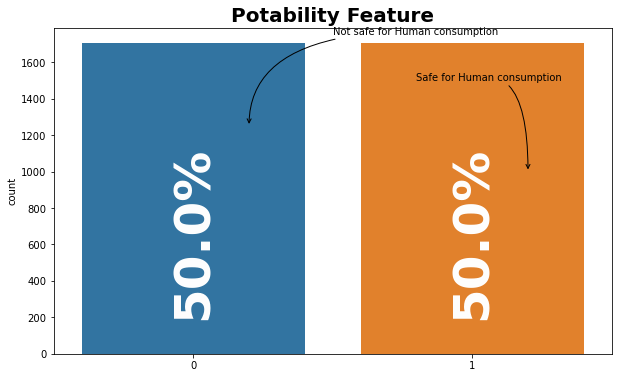

In [183]:
fig = plt.figure(figsize=(10,6))
ax=sns.countplot( x=y_train_SMOTE)
for i in ax.patches:
    ax.text(x=i.get_x()+i.get_width()/2, y=i.get_height()/7, s=f"{np.round(i.get_height()/len(y_train_SMOTE)*100,0)}%", ha='center', size=50, weight='bold', rotation=90, color='white')
plt.title("Potability Feature", size=20, weight='bold')   
plt.annotate(text="Not safe for Human consumption", xytext=(0.5,1750),xy=(0.2,1250), arrowprops =dict(arrowstyle="->", color='black', connectionstyle="angle3,angleA=0,angleB=90"), color='black')
plt.annotate(text="Safe for Human consumption", xytext=(0.8,1500),xy=(1.2,1000), arrowprops =dict(arrowstyle="->", color='black',  connectionstyle="angle3,angleA=0,angleB=90"), color='black')

In [164]:
from sklearn.svm import SVC
from sklearn.metrics import classification_report, roc_auc_score

model=SVC()
clf_SMOTE = model.fit(X_train_SMOTE, y_train_SMOTE)
pred_SMOTE = clf_SMOTE.predict(X_test)

print("ROC AUC score for oversampled SMOTE data: ", roc_auc_score(y_test, pred_SMOTE))

ROC AUC score for oversampled SMOTE data:  0.7310836170027059


In [165]:
from collections import Counter
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
import pandas as pd
import numpy as np
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
from sklearn.svm import SVC
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline

In [156]:
model2 = SVC()
over = SMOTE(sampling_strategy=0.4)
under = RandomUnderSampler(sampling_strategy=0.5)
steps = [('o', over), ('u', under), ('model', model2)]
pipeline = Pipeline(steps=steps)

#PART 2
# import libraries for evaluation
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_auc_score
from numpy import mean


over_values = [0.3,0.4,0.5]
under_values = [0.7,0.6,0.5]
for o in over_values:
 for u in under_values:
    # define pipeline
    model = SVC()
    over = SMOTE(sampling_strategy=o)
    under = RandomUnderSampler(sampling_strategy=u)
    steps = [('over', over), ('under', under), ('model', model)]
    pipeline = Pipeline(steps=steps)
    # evaluate pipeline
    scores = cross_val_score(pipeline, X, y, scoring='roc_auc', cv=5, n_jobs=-1)
    score = mean(scores)
    print('SMOTE oversampling rate:%.1f, Random undersampling rate:%.1f , Mean ROC AUC: %.3f' % (o, u, score))


SMOTE oversampling rate:0.3, Random undersampling rate:0.7 , Mean ROC AUC: nan
SMOTE oversampling rate:0.3, Random undersampling rate:0.6 , Mean ROC AUC: nan
SMOTE oversampling rate:0.3, Random undersampling rate:0.5 , Mean ROC AUC: nan
SMOTE oversampling rate:0.4, Random undersampling rate:0.7 , Mean ROC AUC: nan
SMOTE oversampling rate:0.4, Random undersampling rate:0.6 , Mean ROC AUC: nan
SMOTE oversampling rate:0.4, Random undersampling rate:0.5 , Mean ROC AUC: nan
SMOTE oversampling rate:0.5, Random undersampling rate:0.7 , Mean ROC AUC: nan
SMOTE oversampling rate:0.5, Random undersampling rate:0.6 , Mean ROC AUC: nan
SMOTE oversampling rate:0.5, Random undersampling rate:0.5 , Mean ROC AUC: nan


In [166]:

# evaluates a decision tree model on the imbalanced dataset
from numpy import mean
from sklearn.datasets import make_classification
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
# generate 2 class dataset

model = DecisionTreeClassifier()
# define evaluation procedure
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(model, X, y, scoring='roc_auc', cv=cv, n_jobs=-1)
# summarize performance
print('Mean ROC AUC: %.3f' % mean(scores))

Mean ROC AUC: 0.561


In [167]:
from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

In [168]:
model = DecisionTreeClassifier()
# define resampling
over = RandomOverSampler(sampling_strategy=0.1)
under = RandomUnderSampler(sampling_strategy=0.5)
# define pipeline
pipeline = Pipeline(steps=[('o', over), ('u', under), ('m', model)])

In [169]:
model = DecisionTreeClassifier()
# define resampling
over = RandomOverSampler(sampling_strategy=0.1)
under = RandomUnderSampler(sampling_strategy=0.5)
# define pipeline
pipeline = Pipeline(steps=[('o', over), ('u', under), ('m', model)])
# define evaluation procedure
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(pipeline, X, y, scoring='roc_auc', cv=cv, n_jobs=-1)
# summarize performance
print('Mean ROC AUC: %.3f' % mean(scores))

Mean ROC AUC: nan


In [170]:
model = DecisionTreeClassifier()
# define pipeline
over = SMOTE(sampling_strategy=0.1)
under = RandomUnderSampler(sampling_strategy=0.5)
steps = [('o', over), ('u', under), ('m', model)]

In [171]:

# combination of SMOTE and random undersampling for imbalanced classification
from numpy import mean
from sklearn.datasets import make_classification
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.tree import DecisionTreeClassifier
from imblearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
# generate dataset

model = DecisionTreeClassifier()
# define pipeline
over = SMOTE(sampling_strategy=0.1)
under = RandomUnderSampler(sampling_strategy=0.5)
steps = [('o', over), ('u', under), ('m', model)]
pipeline = Pipeline(steps=steps)
# define evaluation procedure
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(pipeline, X, y, scoring='roc_auc', cv=cv, n_jobs=-1)
# summarize performance
print('Mean ROC AUC: %.3f' % mean(scores))


Mean ROC AUC: nan


In [172]:
resample = SMOTETomek(tomek=TomekLinks(sampling_strategy='majority'))

In [173]:
from numpy import mean
from sklearn.datasets import make_classification
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from imblearn.pipeline import Pipeline
from sklearn.tree import DecisionTreeClassifier
from imblearn.combine import SMOTETomek
from imblearn.under_sampling import TomekLinks
from imblearn.combine import SMOTEENN 

In [174]:
model = DecisionTreeClassifier()
# define resampling
resample = SMOTETomek(tomek=TomekLinks(sampling_strategy='majority'))
# define pipeline
pipeline = Pipeline(steps=[('r', resample), ('m', model)])
# define evaluation procedure
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(pipeline, X, y, scoring='roc_auc', cv=cv, n_jobs=-1)
# summarize performance
print('Mean ROC AUC: %.3f' % mean(scores))


Mean ROC AUC: 0.558


In [175]:
#pip install -U imbalanced-learn


In [190]:
# resample = SMOTEENN()
# resample = SMOTEENN(enn=EditedNearestNeighbours(sampling_strategy='majority'))


In [177]:
# define resampling
resample = SMOTEENN()
# define pipeline
pipeline = Pipeline(steps=[('r', resample), ('m', model)])
# define evaluation procedure
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(pipeline, X, y, scoring='roc_auc', cv=cv, n_jobs=-1)
# summarize performance
print('Mean ROC AUC: %.3f' % mean(scores))

Mean ROC AUC: 0.543


In [89]:
#df11['Potability'] = pd.Categorical(df11.Potability)

df11['Potability'] = pd.to_numeric(df11.Potability)
df11.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3276 entries, 0 to 3275
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ph               3276 non-null   float64
 1   Hardness         3276 non-null   float64
 2   Solids           3276 non-null   float64
 3   Chloramines      3276 non-null   float64
 4   Sulfate          3276 non-null   float64
 5   Conductivity     3276 non-null   float64
 6   Organic_carbon   3276 non-null   float64
 7   Trihalomethanes  3276 non-null   float64
 8   Turbidity        3276 non-null   float64
 9   Potability       3276 non-null   int64  
dtypes: float64(9), int64(1)
memory usage: 256.1 KB


In [195]:
#pip install pycaret

In [90]:
correlation = df11.corr()
correlation["ph"].sort_values(ascending=False)

ph                 1.000000
Hardness           0.075760
Organic_carbon     0.040240
Conductivity       0.017466
Sulfate            0.014178
Trihalomethanes    0.003145
Potability        -0.003014
Chloramines       -0.031741
Turbidity         -0.036107
Solids            -0.082004
Name: ph, dtype: float64

In [193]:
from pycaret.classification import *
df123

NameError: name 'df123' is not defined

In [169]:
clf = setup(df123, target = "Potability", silent = True,fix_imbalance = True,normalize = False,train_size = 0.7, session_id = 786)


,Description,Value
0,session_id,786
1,Target,Potability
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(3276, 10)"
5,Missing Values,False
6,Numeric Features,9
7,Categorical Features,0
8,Ordinal Features,False
9,High Cardinality Features,False


AttributeError: 'Simple_Imputer' object has no attribute 'fill_value_categorical'

In [170]:
compare_models()  # 0.9978	0.9998	0.9968	0.9874	0.9920	0.9907	0.9908

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
xgboost,Extreme Gradient Boosting,0.9983,0.9988,0.9905,0.9970,0.9936,0.9926,0.9927,0.1530
ada,Ada Boost Classifier,0.9978,0.9958,0.9874,0.9970,0.9920,0.9907,0.9909,0.0370
dt,Decision Tree Classifier,0.9974,0.9918,0.9841,0.9970,0.9904,0.9889,0.9890,0.0070
gbc,Gradient Boosting Classifier,0.9974,1.0000,0.9969,0.9849,0.9907,0.9892,0.9893,0.1050
rf,Random Forest Classifier,0.9965,1.0000,0.9746,1.0000,0.9870,0.9850,0.9852,0.0790
lightgbm,Light Gradient Boosting Machine,0.9956,0.9998,0.9938,0.9758,0.9845,0.9819,0.9822,0.6310
et,Extra Trees Classifier,0.9821,0.9967,0.9023,0.9674,0.9326,0.9223,0.9238,0.0580
qda,Quadratic Discriminant Analysis,0.8931,0.9500,0.8415,0.5778,0.6838,0.6222,0.6393,0.0060
nb,Naive Bayes,0.8796,0.9503,0.8670,0.5409,0.6653,0.5967,0.6222,0.0060
knn,K Neighbors Classifier,0.7562,0.8263,0.7629,0.3360,0.4657,0.3384,0.3861,0.0140


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              gamma=0, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
              monotone_constraints='()', n_estimators=100, n_jobs=-1,
              num_parallel_tree=1, objective='binary:logistic',
              predictor='auto', random_state=786, reg_alpha=0, reg_lambda=1,
              scale_pos_weight=1, subsample=1, tree_method='auto',
              use_label_encoder=True, validate_parameters=1, verbosity=0)

In [172]:
model = create_model("xgboost", cross_validation=True, verbose=True)
predict = predict_model(model,probability_threshold=0.2705, data=df123)

predict.head()



,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9957,0.9897,0.9688,1.0000,0.9841,0.9816,0.9818
1,0.9957,0.9998,0.9688,1.0000,0.9841,0.9816,0.9818
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,0.9956,0.9984,0.9677,1.0000,0.9836,0.9811,0.9813
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,0.9956,1.0000,1.0000,0.9697,0.9846,0.9821,0.9822
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
9,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability,Label,Score
0,7.036752,204.890456,20791.31898,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0,0,0.9998
1,3.716080,129.422921,18630.05786,6.635246,333.073546,592.885359,15.180013,56.329076,4.500656,0,0,0.9992
2,8.099124,224.236259,19909.54173,9.275884,333.073546,418.606213,16.868637,66.420093,3.055934,1,1,0.9987
3,8.316766,214.373394,22018.41744,8.059332,356.886136,363.266516,18.436525,100.341674,4.628771,0,0,0.9998
4,9.092223,181.101509,17978.98634,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0,0,0.9950


In [192]:
optimize_threshold(model, true_negative = 1500, false_negative = -5000)

Optimized Probability Threshold: 0.5 | Optimized Cost Function: 1243000


0.5

In [174]:
tuned_dt = tune_model(model)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9957,0.9869,0.9688,1.0000,0.9841,0.9816,0.9818
1,0.9957,0.9998,0.9688,1.0000,0.9841,0.9816,0.9818
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,0.9956,0.9963,0.9677,1.0000,0.9836,0.9811,0.9813
5,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
9,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


In [60]:
tuned_dt = tune_model(model, n_iter = 50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.6646,0.6839,0.6000,0.5735,0.5865,0.3047,0.3049
1,0.6646,0.7057,0.6462,0.5676,0.6043,0.3154,0.3174
2,0.6524,0.6597,0.5692,0.5606,0.5649,0.2756,0.2756
3,0.6646,0.6438,0.6154,0.5714,0.5926,0.3083,0.3089
4,0.6280,0.6582,0.5000,0.5410,0.5197,0.2170,0.2174
5,0.6220,0.6707,0.5455,0.5294,0.5373,0.2178,0.2179
6,0.6341,0.6738,0.5606,0.5441,0.5522,0.2431,0.2432
7,0.6037,0.6170,0.5000,0.5077,0.5038,0.1739,0.1739
8,0.6748,0.7140,0.6308,0.5857,0.6074,0.3306,0.3312
9,0.6564,0.6765,0.6308,0.5616,0.5942,0.2981,0.2996


In [29]:
#!pip install pycaret

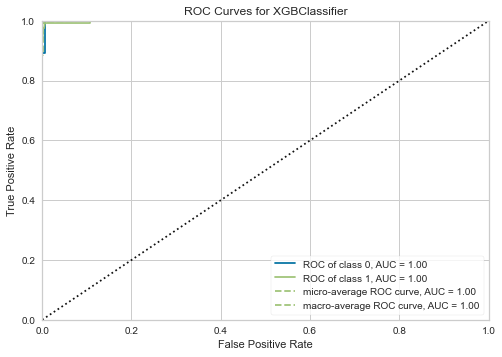

In [175]:
plot_model(tuned_dt, plot = 'auc')

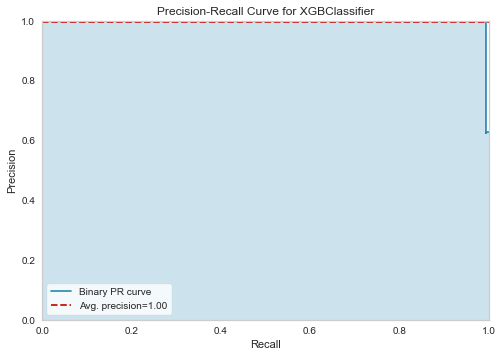

In [176]:
plot_model(tuned_dt, plot = 'pr')

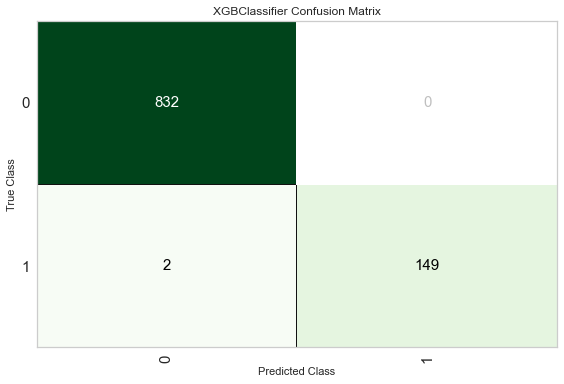

In [177]:
plot_model(tuned_dt, plot = 'confusion_matrix')


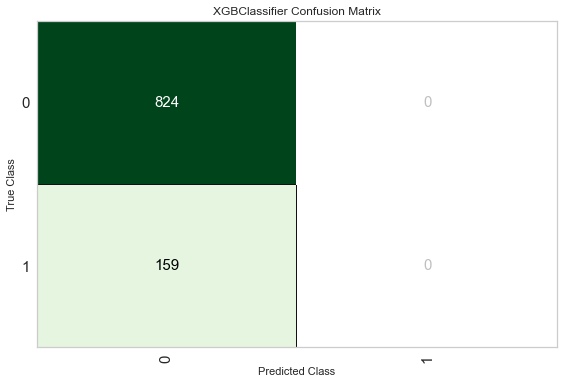

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [384]:
plot_model(tuned_dt, plot = 'confusion_matrix')



interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

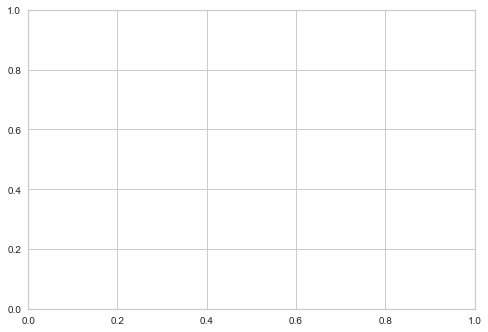

In [179]:
evaluate_model(tuned_dt)

In [180]:
predict_model(tuned_dt);

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extreme Gradient Boosting,0.9980,0.9993,0.9868,1.0000,0.9933,0.9921,0.9922


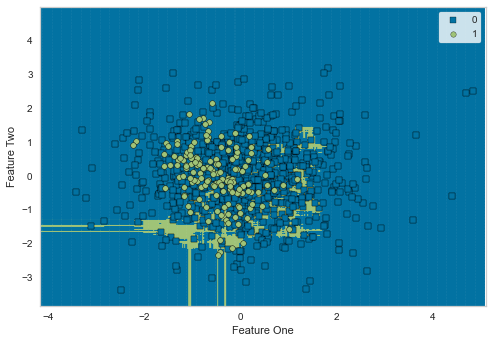

In [181]:
plot_model(tuned_dt, plot = 'boundary')

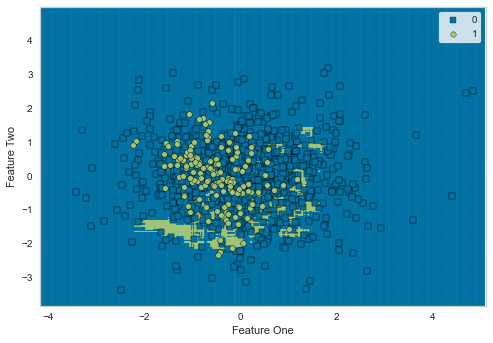

In [182]:
plot_model(model, plot = 'boundary')

In [383]:
unseen_predictions = predict_model(tuned_dt, data=df123)
unseen_predictions.head()

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
              gamma=0, gpu_id=-1, importance_type=None,
              interaction_constraints='', learning_rate=0.4, max_delta_step=0,
              max_depth=8, min_child_weight=4, missing=nan,
              monotone_constraints='()', n_estimators=270, n_jobs=-1,
              num_parallel_tree=1, objective='binary:logistic',
              predictor='auto', random_state=786, reg_alpha=0.0005,
              reg_lambda=0.15, scale_pos_weight=5.2, subsample=0.9,
              tree_method='auto', use_label_encoder=True, validate_parameters=1,
              verbosity=0), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
IN

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability,Label,Score
0,7.036752,204.890456,20791.31898,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0,0,0.9969
1,3.716080,129.422921,18630.05786,6.635246,333.073546,592.885359,15.180013,56.329076,4.500656,0,0,0.9969
2,8.099124,224.236259,19909.54173,9.275884,333.073546,418.606213,16.868637,66.420093,3.055934,1,0,0.9969
3,8.316766,214.373394,22018.41744,8.059332,356.886136,363.266516,18.436525,100.341674,4.628771,0,0,0.9969
4,9.092223,181.101509,17978.98634,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0,0,0.9969


In [5]:
from imblearn.over_sampling import *
adasyn1 = ADASYN(sampling_strategy='minority')

In [343]:
Session_2 = setup(df11, target = 'Potability', session_id=177, log_experiment=True, 
                  experiment_name='Potability2', normalize=False, normalize_method='zscore', 
                  transformation=True, transformation_method = 'quantile', fix_imbalance=True,
                  fix_imbalance_method= adasyn1)



,Description,Value
0,session_id,177
1,Target,Potability
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(3276, 10)"
5,Missing Values,False
6,Numeric Features,9
7,Categorical Features,0
8,Ordinal Features,False
9,High Cardinality Features,False


INFO:logs:Logging experiment in MLFlow
  File "/Users/safarji/opt/anaconda3/lib/python3.8/site-packages/pycaret/internal/tabular.py", line 1702, in setup
    mlflow.create_experiment(exp_name_log)
  File "/Users/safarji/opt/anaconda3/lib/python3.8/site-packages/mlflow/tracking/fluent.py", line 876, in create_experiment
    return MlflowClient().create_experiment(name, artifact_location, tags)
  File "/Users/safarji/opt/anaconda3/lib/python3.8/site-packages/mlflow/tracking/client.py", line 507, in create_experiment
    return self._tracking_client.create_experiment(name, artifact_location, tags)
  File "/Users/safarji/opt/anaconda3/lib/python3.8/site-packages/mlflow/tracking/_tracking_service/client.py", line 178, in create_experiment
    return self.store.create_experiment(
  File "/Users/safarji/opt/anaconda3/lib/python3.8/site-packages/mlflow/store/tracking/file_store.py", line 317, in create_experiment
    self._validate_experiment_name(name)
  File "/Users/safarji/opt/anaconda3/lib

AttributeError: 'Simple_Imputer' object has no attribute 'fill_value_categorical'

In [344]:
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
et,Extra Trees Classifier,0.6611,0.6736,0.4173,0.5868,0.4866,0.2443,0.2530,0.0680
rf,Random Forest Classifier,0.6463,0.6656,0.4988,0.5452,0.5200,0.2412,0.2423,0.0970
catboost,CatBoost Classifier,0.6293,0.6743,0.5204,0.5190,0.5195,0.2178,0.2179,0.4340
xgboost,Extreme Gradient Boosting,0.6214,0.6525,0.4977,0.5101,0.5027,0.1976,0.1982,0.3090
lightgbm,Light Gradient Boosting Machine,0.6201,0.6589,0.5147,0.5092,0.5108,0.2008,0.2013,0.7070
qda,Quadratic Discriminant Analysis,0.6088,0.6741,0.6054,0.4927,0.5431,0.2073,0.2110,0.0090
knn,K Neighbors Classifier,0.5901,0.6229,0.5988,0.4738,0.5288,0.1746,0.1786,0.0170
gbc,Gradient Boosting Classifier,0.5795,0.6142,0.5407,0.4604,0.4968,0.1399,0.1415,0.0830
dt,Decision Tree Classifier,0.5622,0.5499,0.4966,0.4388,0.4654,0.0972,0.0980,0.0140
nb,Naive Bayes,0.5368,0.5700,0.5793,0.4239,0.4892,0.0833,0.0876,0.0080


INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 2
INFO:logs:ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_samples_leaf=1,
                     min_samples_split=2, min_weight_fraction_leaf=0.0,
                     n_estimators=100, n_jobs=-1, oob_score=False,
                     random_state=177, verbose=0, warm_start=False)
INFO:logs:compare_models() succesfully completed......................................


ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_samples_leaf=1,
                     min_samples_split=2, min_weight_fraction_leaf=0.0,
                     n_estimators=100, n_jobs=-1, oob_score=False,
                     random_state=177, verbose=0, warm_start=False)

In [114]:
lod  = create_model('et')  

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.6478,0.6939,0.5275,0.5581,0.5424,0.2565,0.2568
1,0.6217,0.6802,0.5055,0.5227,0.5140,0.2045,0.2046
2,0.6304,0.6550,0.4286,0.5417,0.4785,0.1983,0.2016
3,0.6376,0.7092,0.4222,0.5507,0.4780,0.2077,0.2120
4,0.6026,0.5950,0.4505,0.5000,0.4740,0.1561,0.1566
5,0.6288,0.6586,0.4286,0.5417,0.4785,0.1964,0.1997
6,0.6201,0.6198,0.4286,0.5270,0.4727,0.1807,0.1831
7,0.6463,0.6906,0.4725,0.5658,0.5150,0.2401,0.2426
8,0.6070,0.6116,0.4286,0.5065,0.4643,0.1573,0.1587
9,0.6812,0.6875,0.5495,0.6098,0.5780,0.3230,0.3241


In [111]:
model = create_model("et", cross_validation=True, verbose=True)
predict = predict_model(model,probability_threshold=0.2973, data=df11)

predict.head()

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.6478,0.6939,0.5275,0.5581,0.5424,0.2565,0.2568
1,0.6217,0.6802,0.5055,0.5227,0.5140,0.2045,0.2046
2,0.6304,0.6550,0.4286,0.5417,0.4785,0.1983,0.2016
3,0.6376,0.7092,0.4222,0.5507,0.4780,0.2077,0.2120
4,0.6026,0.5950,0.4505,0.5000,0.4740,0.1561,0.1566
5,0.6288,0.6586,0.4286,0.5417,0.4785,0.1964,0.1997
6,0.6201,0.6198,0.4286,0.5270,0.4727,0.1807,0.1831
7,0.6463,0.6906,0.4725,0.5658,0.5150,0.2401,0.2426
8,0.6070,0.6116,0.4286,0.5065,0.4643,0.1573,0.1587
9,0.6812,0.6875,0.5495,0.6098,0.5780,0.3230,0.3241


,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability,Label,Score
0,7.036752,204.890455,20791.318981,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0,1,0.39
1,3.716080,129.422921,18630.057858,6.635246,333.073546,592.885359,15.180013,56.329076,4.500656,0,0,1.00
2,8.099124,224.236259,19909.541732,9.275884,333.073546,418.606213,16.868637,66.420093,3.055934,0,1,0.36
3,8.316766,214.373394,22018.417441,8.059332,356.886136,363.266516,18.436524,100.341674,4.628771,0,0,1.00
4,9.092223,181.101509,17978.986339,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0,0,1.00


In [96]:
optimize_threshold(model, true_negative = 1500, false_negative = -5000)

Optimized Probability Threshold: 0.2973 | Optimized Cost Function: 70500


0.2973

In [99]:
#lightgbm = create_model('et', cross_validation=True, verbose=True)
test_data = pd.read_csv('water1.csv')
predict = predict_model(model, data=test_data)
predict

,Unnamed: 0,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability,Label,Score
0,0,7.036752,204.890455,20791.318981,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0,0,0.61
1,1,3.716080,129.422921,18630.057858,6.635246,333.073546,592.885359,15.180013,56.329076,4.500656,0,0,1.00
2,2,8.099124,224.236259,19909.541732,9.275884,333.073546,418.606213,16.868637,66.420093,3.055934,0,0,0.64
3,3,8.316766,214.373394,22018.417441,8.059332,356.886136,363.266516,18.436524,100.341674,4.628771,0,0,1.00
4,4,9.092223,181.101509,17978.986339,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0,0,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3271,3271,4.668102,193.681735,47580.991603,7.166639,359.948574,526.424171,13.894419,66.687695,4.435821,1,1,1.00
3272,3272,7.808856,193.553212,17329.802160,8.061362,333.073546,392.449580,19.903225,66.622485,2.798243,1,1,1.00
3273,3273,9.419510,175.762646,33155.578218,7.350233,333.073546,432.044783,11.039070,69.845400,3.298875,1,1,1.00
3274,3274,5.126763,230.603758,11983.869376,6.303357,333.073546,402.883113,11.168946,77.488213,4.708658,1,1,1.00


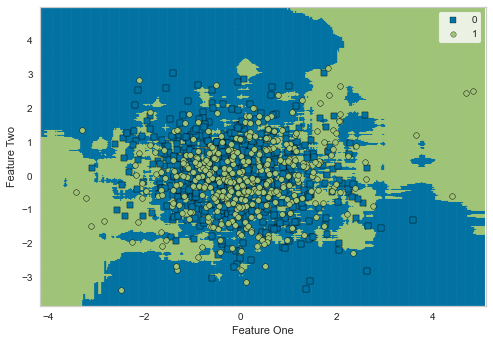

In [100]:
plot_model(model, plot = 'boundary')

In [117]:
tuned_dt = tune_model(model, n_iter = 20)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.6000,0.6449,0.5385,0.4949,0.5158,0.1761,0.1765
1,0.5913,0.6226,0.4835,0.4835,0.4835,0.1454,0.1454
2,0.6391,0.6548,0.5055,0.5476,0.5257,0.2352,0.2357
3,0.6245,0.6571,0.5889,0.5196,0.5521,0.2309,0.2323
4,0.5764,0.5694,0.5165,0.4700,0.4921,0.1302,0.1307
5,0.5895,0.6120,0.4396,0.4819,0.4598,0.1299,0.1303
6,0.5852,0.6229,0.4725,0.4778,0.4751,0.1322,0.1322
7,0.6376,0.6444,0.5275,0.5455,0.5363,0.2390,0.2390
8,0.5764,0.5725,0.4615,0.4667,0.4641,0.1139,0.1139
9,0.6419,0.6376,0.4615,0.5600,0.5060,0.2293,0.2319


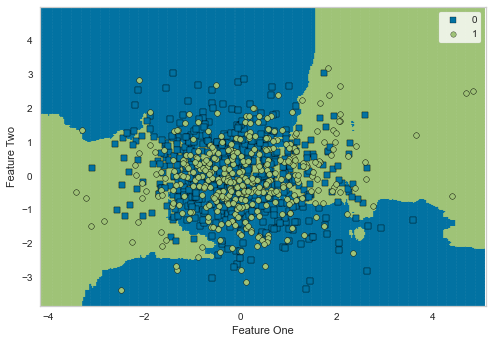

In [102]:
plot_model(tuned_dt, plot = 'boundary')

In [105]:
# tune hyperparameters of decision tree
tuned_dt = tune_model(model)
# tune hyperparameters with increased n_iter
tuned_dt = tune_model(model, n_iter = 50)
# tune hyperparameters to optimize AUC
tuned_dt = tune_model(model, optimize = 'AUC') #default is 'Accuracy'
# tune hyperparameters with custom_grid
params = {"max_depth": np.random.randint(1, (len(df11.columns)*.85),20),
          "max_features": np.random.randint(1, len(df11.columns),20),
          "min_samples_leaf": [2,3,4,5,6],
          "criterion": ["gini", "entropy"]
          }
tuned_dt_custom = tune_model(model, custom_grid = params)
# tune multiple models dynamically
top3 = compare_models(n_select = 3)
tuned_top3 = [tune_model(i) for i in top3]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.6043,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000
1,0.6043,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000
2,0.6043,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000
3,0.6070,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000
4,0.6026,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000
5,0.6026,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000
6,0.6026,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000
7,0.6026,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000
8,0.6026,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000
9,0.6026,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000


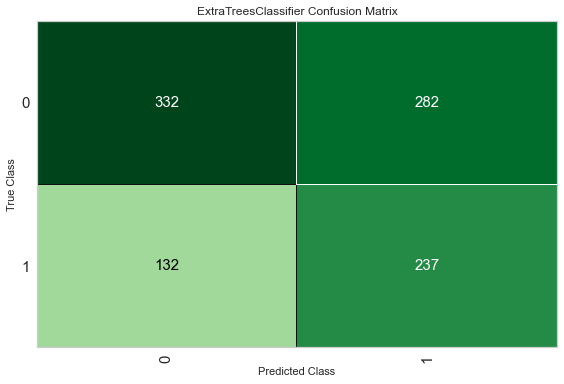

In [106]:
plot_model(tuned_dt, plot = 'confusion_matrix')


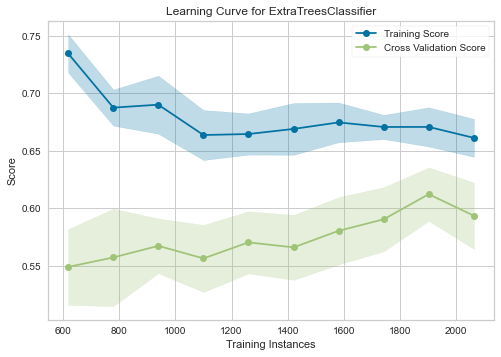

In [107]:
plot_model(estimator = tuned_dt, plot = 'learning')

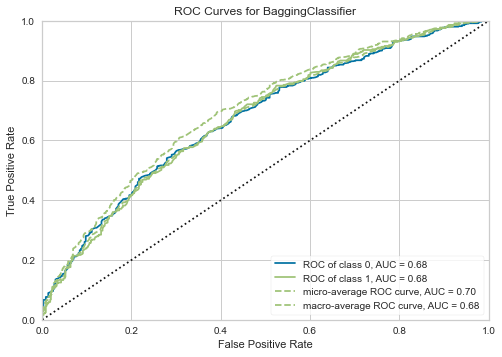

In [122]:
plot_model(estimator = bagged_dt, plot = 'auc')

In [123]:
dt = create_model('et')
bagged_dt = ensemble_model(dt, method = 'Bagging') #Boosting

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.6913,0.7235,0.5714,0.6190,0.5943,0.3458,0.3465
1,0.6000,0.6699,0.5165,0.4947,0.5054,0.1699,0.1700
2,0.6261,0.6452,0.4066,0.5362,0.4625,0.1841,0.1882
3,0.6550,0.6944,0.4444,0.5797,0.5031,0.2459,0.2510
4,0.6157,0.6242,0.4945,0.5172,0.5056,0.1916,0.1917
5,0.6725,0.6747,0.4615,0.6176,0.5283,0.2854,0.2925
6,0.6550,0.6612,0.4945,0.5769,0.5325,0.2617,0.2637
7,0.6245,0.6730,0.4396,0.5333,0.4819,0.1917,0.1939
8,0.6070,0.6106,0.4615,0.5060,0.4828,0.1669,0.1674
9,0.6114,0.6666,0.4396,0.5128,0.4734,0.1683,0.1695


In [124]:
top3 = compare_models(n_select = 3)
blender = blend_models(top3)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.6696,0.7172,0.5385,0.5904,0.5632,0.2984,0.2992
1,0.6435,0.6665,0.5495,0.5495,0.5495,0.2545,0.2545
2,0.6652,0.6783,0.5385,0.5833,0.5600,0.2905,0.2911
3,0.6638,0.7317,0.5111,0.5823,0.5444,0.2797,0.2812
4,0.5895,0.6345,0.4835,0.4835,0.4835,0.1429,0.1429
5,0.6594,0.6921,0.5275,0.5783,0.5517,0.2780,0.2788
6,0.6463,0.6534,0.4725,0.5658,0.5150,0.2401,0.2426
7,0.6201,0.6874,0.4725,0.5244,0.4971,0.1932,0.1938
8,0.6201,0.6380,0.5275,0.5217,0.5246,0.2082,0.2083
9,0.6769,0.7076,0.5934,0.5934,0.5934,0.3253,0.3253


In [6]:
from pycaret.classification import *

#exp_name = setup(data = df11,  target = 'Potability',  fix_imbalance = True)

In [138]:
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
et,Extra Trees Classifier,0.6493,0.6582,0.3850,0.5740,0.4606,0.2154,0.2251,0.0670
rf,Random Forest Classifier,0.6411,0.6543,0.4523,0.5462,0.4944,0.2201,0.2227,0.0990
qda,Quadratic Discriminant Analysis,0.6193,0.6692,0.5646,0.5093,0.5347,0.2143,0.2156,0.0070
lightgbm,Light Gradient Boosting Machine,0.6171,0.6452,0.5005,0.5072,0.5033,0.1920,0.1923,0.6690
xgboost,Extreme Gradient Boosting,0.6140,0.6457,0.5051,0.5038,0.5036,0.1882,0.1887,0.2970
gbc,Gradient Boosting Classifier,0.5814,0.6163,0.5208,0.4657,0.4908,0.1376,0.1386,0.0810
knn,K Neighbors Classifier,0.5774,0.5957,0.5331,0.4634,0.4952,0.1354,0.1365,0.0130
dt,Decision Tree Classifier,0.5635,0.5480,0.4782,0.4437,0.4594,0.0947,0.0950,0.0080
nb,Naive Bayes,0.5395,0.5619,0.4815,0.4183,0.4463,0.0559,0.0567,0.0060
ada,Ada Boost Classifier,0.5137,0.5189,0.4680,0.3939,0.4267,0.0103,0.0106,0.0320


ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='auto',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_samples_leaf=1,
                     min_samples_split=2, min_weight_fraction_leaf=0.0,
                     n_estimators=100, n_jobs=-1, oob_score=False,
                     random_state=7200, verbose=0, warm_start=False)

In [142]:
dtt = create_model('et')
# train a bagging classifier on dt

# train a adaboost classifier on dt with 100 estimators
boosted_dt = ensemble_model(dtt, method = 'Boosting', n_estimators = 100)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.6174,0.6781,0.4719,0.5060,0.4884,0.1834,0.1837
1,0.6739,0.7013,0.5506,0.5833,0.5665,0.3055,0.3058
2,0.6087,0.5939,0.4270,0.4935,0.4578,0.1542,0.1552
3,0.6332,0.6667,0.3977,0.5303,0.4545,0.1866,0.1910
4,0.6594,0.6593,0.4432,0.5735,0.5000,0.2481,0.2528
5,0.6507,0.6744,0.4545,0.5556,0.5000,0.2356,0.2385
6,0.6769,0.6940,0.5114,0.5921,0.5488,0.2992,0.3011
7,0.6419,0.6781,0.4886,0.5375,0.5119,0.2302,0.2308
8,0.6725,0.6778,0.4659,0.5942,0.5223,0.2786,0.2834
9,0.6419,0.6401,0.4205,0.5441,0.4744,0.2095,0.2136


In [143]:
bagged_dt = ensemble_model(dtt, method = 'Bagging')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.6391,0.7026,0.5169,0.5349,0.5257,0.2346,0.2347
1,0.6783,0.7172,0.5618,0.5882,0.5747,0.3162,0.3164
2,0.6304,0.6308,0.5169,0.5227,0.5198,0.2194,0.2194
3,0.5983,0.6470,0.3864,0.4722,0.4250,0.1210,0.1224
4,0.6419,0.6480,0.4773,0.5385,0.5060,0.2268,0.2278
5,0.5983,0.6302,0.4545,0.4762,0.4651,0.1437,0.1438
6,0.6419,0.6982,0.5000,0.5366,0.5176,0.2335,0.2339
7,0.6463,0.6893,0.5682,0.5376,0.5525,0.2604,0.2607
8,0.6332,0.6568,0.4886,0.5244,0.5059,0.2148,0.2151
9,0.6594,0.6557,0.5000,0.5641,0.5301,0.2645,0.2657


In [7]:
df123= pd.read_csv('waterNew.csv')

In [8]:

df123.drop(['Unnamed: 0'], axis=1, inplace=True)

In [9]:
df123.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3276 entries, 0 to 3275
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   ph               3276 non-null   float64
 1   Hardness         3276 non-null   float64
 2   Solids           3276 non-null   float64
 3   Chloramines      3276 non-null   float64
 4   Sulfate          3276 non-null   float64
 5   Conductivity     3276 non-null   float64
 6   Organic_carbon   3276 non-null   float64
 7   Trihalomethanes  3276 non-null   float64
 8   Turbidity        3276 non-null   float64
 9   Potability       3276 non-null   int64  
dtypes: float64(9), int64(1)
memory usage: 256.1 KB


In [10]:
Session_3 = setup(df123, target = 'Potability', session_id=177, log_experiment=True, 
                  experiment_name='Potability2', normalize=True, normalize_method='zscore', 
                  transformation=True, transformation_method = 'quantile', fix_imbalance=True,
                  fix_imbalance_method= adasyn1,imputation_type='iterative')



,Description,Value
0,session_id,177
1,Target,Potability
2,Target Type,Binary
3,Label Encoded,None
4,Original Data,"(3276, 10)"
5,Missing Values,False
6,Numeric Features,9
7,Categorical Features,0
8,Ordinal Features,False
9,High Cardinality Features,False


In [204]:
compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
gbc,Gradient Boosting Classifier,0.9983,0.9994,0.9968,0.9905,0.9935,0.9925,0.9926,0.1090
ada,Ada Boost Classifier,0.9974,0.9975,0.9839,0.9968,0.9902,0.9887,0.9888,0.0380
rf,Random Forest Classifier,0.9970,0.9996,0.9774,1.0000,0.9885,0.9867,0.9869,0.0730
xgboost,Extreme Gradient Boosting,0.9965,0.9971,0.9774,0.9969,0.9869,0.9849,0.9850,0.1540
catboost,CatBoost Classifier,0.9961,1.0000,0.9839,0.9876,0.9855,0.9832,0.9834,0.4430
lightgbm,Light Gradient Boosting Machine,0.9956,0.9966,0.9839,0.9842,0.9838,0.9813,0.9814,0.4370
dt,Decision Tree Classifier,0.9948,0.9874,0.9774,0.9842,0.9806,0.9776,0.9777,0.0080
et,Extra Trees Classifier,0.9765,0.9962,0.8609,0.9625,0.9074,0.8940,0.8967,0.0570
nb,Naive Bayes,0.8849,0.9548,0.9028,0.5510,0.6823,0.6177,0.6470,0.1150
qda,Quadratic Discriminant Analysis,0.8849,0.9498,0.8738,0.5515,0.6745,0.6095,0.6343,0.0060


GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_impurity_split=None,
                           min_samples_leaf=1, min_samples_split=2,
                           min_weight_fraction_leaf=0.0, n_estimators=100,
                           n_iter_no_change=None, presort='deprecated',
                           random_state=177, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)

In [11]:
dta= create_model('rf')
exboost= create_model('xgboost')
#bagged_dts = ensemble_model(dta, method = 'Bagging') #Boosting


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9957,0.9966,0.9677,1.0000,0.9836,0.9811,0.9813
1,0.9957,0.9942,0.9677,1.0000,0.9836,0.9811,0.9813
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
4,0.9956,0.9998,0.9677,1.0000,0.9836,0.9811,0.9813
5,0.9956,0.9888,0.9677,1.0000,0.9836,0.9811,0.9813
6,0.9956,0.9946,0.9677,1.0000,0.9836,0.9811,0.9813
7,0.9956,0.9995,1.0000,0.9688,0.9841,0.9816,0.9818
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
9,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


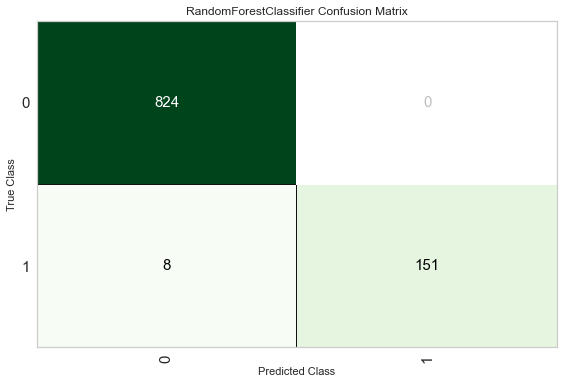

In [247]:
plot_model(dta, plot = 'confusion_matrix')


In [19]:

save_model(dta,'dt_saved_07032020')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=[],
                                       target='Potability', time_features=[])),
                 ('imputer',
                  Iterative_Imputer(add_indicator=False,
                                    classifier=LGBMClassifier(boosting_type='gbdt',
                                                              class_weight=None,
                                                              colsample_by...
                                             learning_rate=0.1, loss='deviance',
                                             max_depth=3, max_features=None,
                                             max_leaf_n

In [27]:
load_clf= load_model('dt_saved_07032020')

Transformation Pipeline and Model Successfully Loaded


In [234]:
interpret_model(exboost, plot='reason',observation = 10)

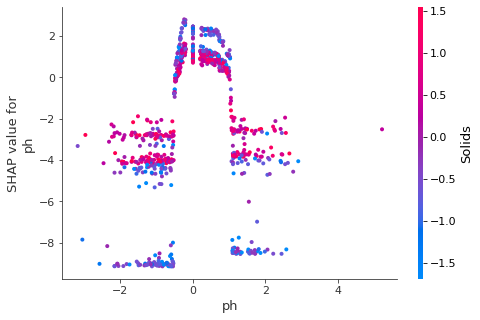

In [233]:
interpret_model(exboost, plot = 'correlation')

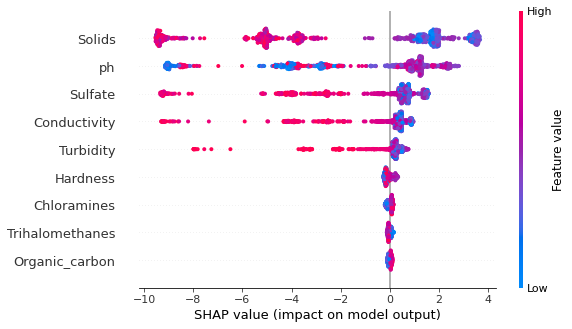

In [232]:
#vv =load_clf.predict(df123)
interpret_model(exboost)

In [88]:
#evaluate_model(vv)

In [12]:
#pip install shap
evaluate_model(dta)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

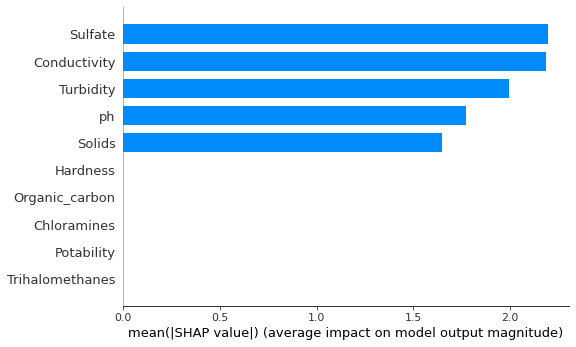

In [228]:
import shap
shap_values = shap.TreeExplainer(dta).shap_values(df123)
shap.summary_plot(shap_values, df123, plot_type="bar",max_display=12)


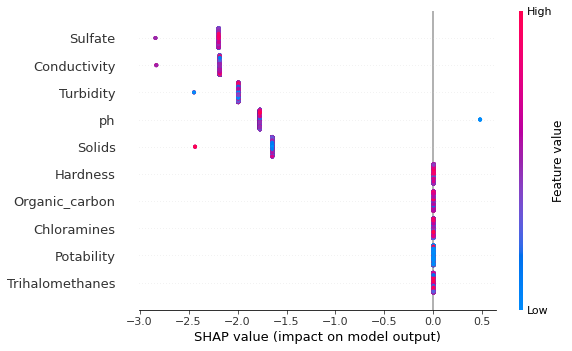

In [231]:
import shap
shap_values = shap.TreeExplainer(dta).shap_values(df123)
shap.summary_plot(shap_values, df123, )

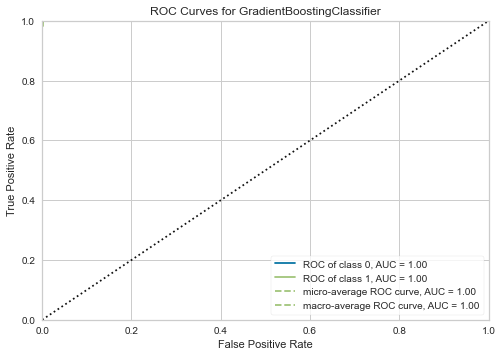

In [77]:
#interpret_model(dta)
#interpret_model(dta, plot = 'correlation')
plot_model(dta)

#plot_model(load_clf, plot = 'confusion_matrix')


In [60]:
#explainer = shap.Explainer(load_clf.predict, df123)


In [37]:
unseen_predictions = predict_model(load_clf, data=df123)
unseen_predictions.head()

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability,Label,Score
0,7.036752,204.890456,20791.31898,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0,0,0.9999
1,3.716080,129.422921,18630.05786,6.635246,333.073546,592.885359,15.180013,56.329076,4.500656,0,0,0.9998
2,8.099124,224.236259,19909.54173,9.275884,333.073546,418.606213,16.868637,66.420093,3.055934,1,1,0.9932
3,8.316766,214.373394,22018.41744,8.059332,356.886136,363.266516,18.436525,100.341674,4.628771,0,0,0.9999
4,9.092223,181.101509,17978.98634,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0,0,0.9795


In [52]:
from pycaret.utils import check_metric
check_metric(unseen_predictions['Potability'], unseen_predictions['Label'], metric = 'Accuracy')

0.9997

In [20]:
#pip install scikit-learn==0.23.2

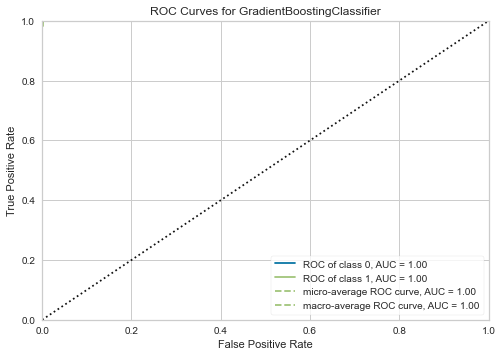

In [21]:
plot_model(estimator = dta, plot = 'auc')

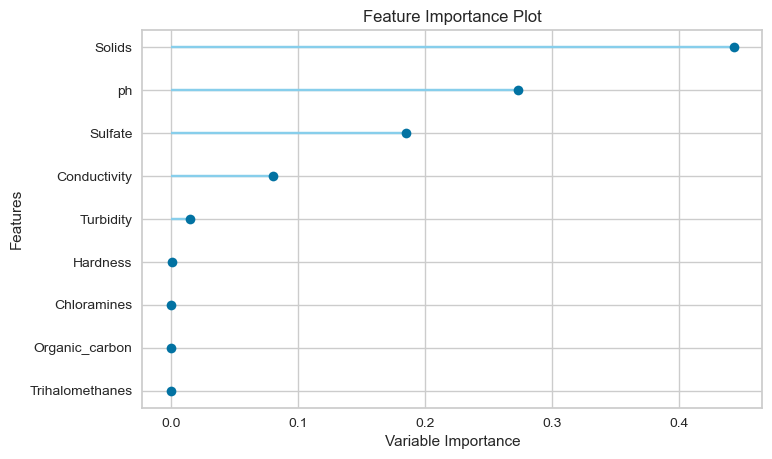

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [365]:
plot_model(dta,plot='feature')

In [366]:
modell = create_model("gbc", cross_validation=True, verbose=True)
predict = predict_model(modell,probability_threshold=0.6433, data=df123)

predict.head()



,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9957,0.9998,1.0000,0.9688,0.9841,0.9816,0.9818
1,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
2,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
3,0.9956,1.0000,1.0000,0.9677,0.9836,0.9811,0.9813
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,0.9956,0.9936,0.9677,1.0000,0.9836,0.9811,0.9813
6,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
7,0.9956,1.0000,1.0000,0.9688,0.9841,0.9816,0.9818
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
9,0.9956,1.0000,1.0000,0.9688,0.9841,0.9816,0.9818


INFO:logs:create_model_container: 17
INFO:logs:master_model_container: 17
INFO:logs:display_container: 4
INFO:logs:GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=177, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                          

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability,Label,Score
0,7.036752,204.890456,20791.31898,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0,0,0.9999
1,3.716080,129.422921,18630.05786,6.635246,333.073546,592.885359,15.180013,56.329076,4.500656,0,0,0.9998
2,8.099124,224.236259,19909.54173,9.275884,333.073546,418.606213,16.868637,66.420093,3.055934,1,1,0.9932
3,8.316766,214.373394,22018.41744,8.059332,356.886136,363.266516,18.436525,100.341674,4.628771,0,0,0.9999
4,9.092223,181.101509,17978.98634,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0,0,0.9795


In [367]:
optimize_threshold(modell, true_negative = 1500, false_negative = -5000)

INFO:logs:Initializing optimize_threshold()
INFO:logs:optimize_threshold(estimator=GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=177, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False), true_positive=0, true_negative=1500, false_positive=0, false_negative=-5000)
INFO:logs:Importing libraries
INFO:logs:Checking exceptions
INFO:logs:Defining loss function
INFO:logs:Iteration starts at 0
INFO:logs:Figure ready for render


INFO:logs:optimize_threshold() succesfully completed......................................


Optimized Probability Threshold: 0.5 | Optimized Cost Function: 1234500


0.5

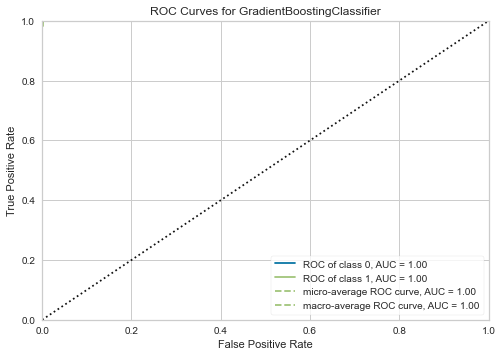

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [368]:
plot_model(modell, plot = 'auc')

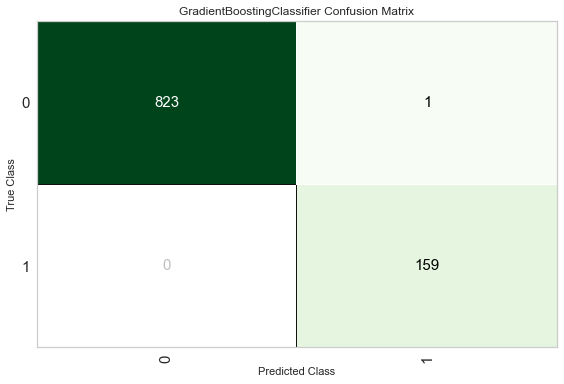

In [22]:
plot_model(dta, plot = 'confusion_matrix')

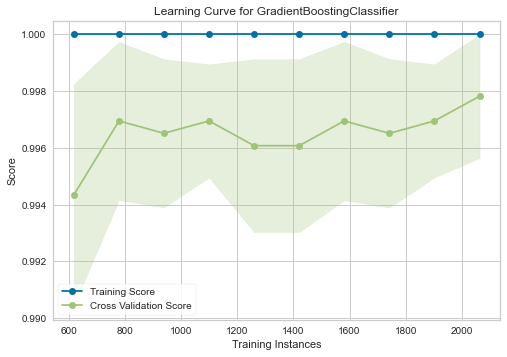

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [370]:
plot_model(estimator = modell, plot = 'learning')

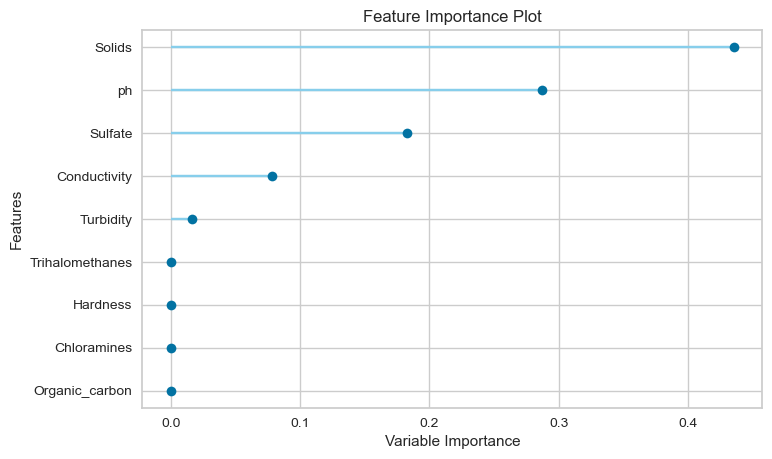

In [205]:
plot_model(modell,plot='feature')

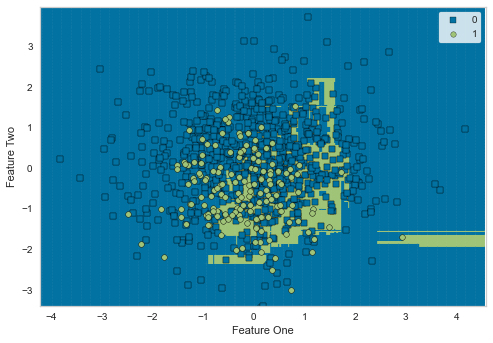

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [371]:
plot_model(modell, plot = 'boundary')

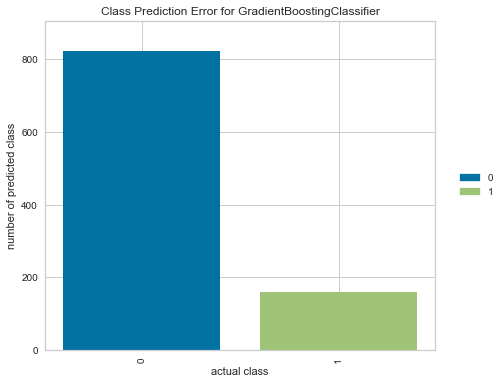

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [372]:
plot_model(modell,plot='error')

In [303]:
evaluate_model(modell)

INFO:logs:Initializing evaluate_model()
INFO:logs:evaluate_model(estimator=GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=786, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False), fold=None, fit_kwargs=None, feature_name=None, groups=None, use_train_data=False)


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

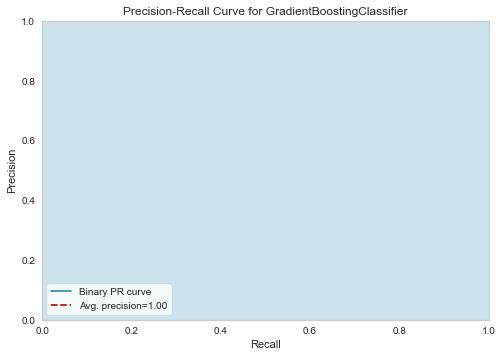

In [211]:
plot_model(modell, plot = 'pr') 

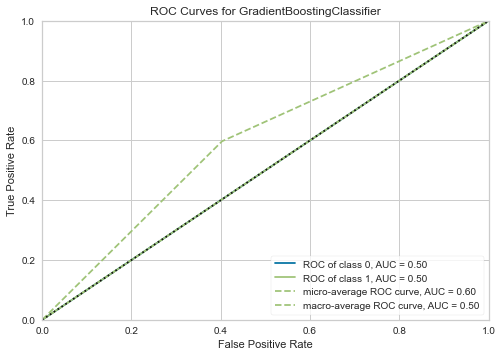

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [345]:
plot_model(modell)

In [373]:
predict_model(modell);

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=177, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Gradient Boosting Classifier,0.9990,1.0000,1.0000,0.9938,0.9969,0.9963,0.9963


In [374]:
final = finalize_model(modell)

INFO:logs:Initializing finalize_model()
INFO:logs:finalize_model(estimator=GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=177, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False), fit_kwargs=None, groups=None, model_only=True, display=None)
INFO:logs:Finalizing GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None

In [375]:


print(final)

GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=177, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)


In [376]:
predict_model(final)

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=177, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Gradient Boosting Classifier,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000


,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability,Label,Score
0,0.010037,0.275628,-1.027348,1.272911,-0.294932,-0.681066,-1.717757,0.666857,0.359208,1,1,0.9932
1,-1.128489,-0.561857,0.047445,-0.262349,0.724233,-0.039943,-0.309138,0.227921,-1.106301,0,0,1.0000
2,-1.660968,-0.390621,0.720166,-0.234017,0.768394,-0.494109,-0.072674,0.577163,1.211711,0,0,1.0000
3,1.067524,1.299831,0.797715,0.802461,1.350684,0.659171,-2.450643,-1.701560,-0.013774,0,0,0.9997
4,0.271733,0.330172,0.494517,0.470493,-0.565791,0.697757,0.416431,-1.141547,0.994832,0,0,0.9919
...,...,...,...,...,...,...,...,...,...,...,...,...
978,-0.423782,1.299535,-1.101249,0.148045,-0.323152,0.356263,1.633162,0.490573,0.486695,1,1,0.9932
979,-0.619667,0.351671,-1.832342,-0.753953,-1.349257,0.779719,-1.130128,0.571166,0.671146,0,0,0.9835
980,0.270279,0.070922,-1.044630,-0.907781,0.703495,0.170242,1.447406,-0.927038,-2.192228,0,0,0.9819
981,-0.864233,-0.228565,-1.112151,1.190498,-0.496056,0.867787,-0.539207,-0.827611,1.188638,0,0,0.9975


In [377]:
test_data1 = pd.read_csv('waterNew.csv')
test_data1.drop(['Unnamed: 0'],  axis=1 , inplace=True)

#predict = predict_model(model, data=test_data)
#predict|
test_data1.head()

,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability
0,7.036752,204.890456,20791.31898,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0
1,3.716080,129.422921,18630.05786,6.635246,333.073546,592.885359,15.180013,56.329076,4.500656,0
2,8.099124,224.236259,19909.54173,9.275884,333.073546,418.606213,16.868637,66.420093,3.055934,1
3,8.316766,214.373394,22018.41744,8.059332,356.886136,363.266516,18.436525,100.341674,4.628771,0
4,9.092223,181.101509,17978.98634,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0


In [378]:
unseen_predictions = predict_model(final, data=test_data1)
unseen_predictions.head()

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=177, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False), probability_threshold=None, encoded_labels=False, raw_score=False, round=4, verbose=True, ml_usecase=MLUsecase.CLASSIFICATION, display=None)
INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor


,ph,Hardness,Solids,Chloramines,Sulfate,Conductivity,Organic_carbon,Trihalomethanes,Turbidity,Potability,Label,Score
0,7.036752,204.890456,20791.31898,7.300212,368.516441,564.308654,10.379783,86.990970,2.963135,0,0,1.0000
1,3.716080,129.422921,18630.05786,6.635246,333.073546,592.885359,15.180013,56.329076,4.500656,0,0,0.9995
2,8.099124,224.236259,19909.54173,9.275884,333.073546,418.606213,16.868637,66.420093,3.055934,1,1,0.9932
3,8.316766,214.373394,22018.41744,8.059332,356.886136,363.266516,18.436525,100.341674,4.628771,0,0,0.9996
4,9.092223,181.101509,17978.98634,6.546600,310.135738,398.410813,11.558279,31.997993,4.075075,0,0,0.9781


In [348]:
evaluate_model(modell)

INFO:logs:Initializing evaluate_model()
INFO:logs:evaluate_model(estimator=GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='deviance', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=786, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False), fold=None, fit_kwargs=None, feature_name=None, groups=None, use_train_data=False)


interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [379]:
from pycaret.utils import check_metric
check_metric(unseen_predictions['Potability'], unseen_predictions['Label'], metric = 'Accuracy')

1.0

In [380]:
import pandas as pd
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.ensemble import GradientBoostingClassifier

In [381]:
df00= pd.read_csv("waterNew.csv")

In [382]:
clf = GradientBoostingClassifier(n_estimators=100, learning_rate=1.0,
max_depth=1, random_state=0).fit(X_train, y_train)
clf.score(X_test, y_test)


0.669379450661241

In [18]:
#l = load_model('abc')